# Problem 9.1: Caulobacter growth

## Anvita Mishra (Group 5)

In [193]:
# Import statements
import os
import numpy as np
import scipy.ndimage
import scipy.spatial

import skimage.feature
import skimage.filters
import skimage.morphology
import skimage.segmentation
import skimage.io
import glob
import bebi103
import pandas as pd
# A whole bunch of skimage stuff
import skimage.feature
import skimage.filters
import skimage.filters.rank
import skimage.io
import skimage.morphology
import skimage.restoration
import skimage.segmentation
import skimage.transform
import collections
import corner

from skimage.morphology import erosion, dilation, opening, closing, white_tophat

# Plotting modules
import matplotlib.pyplot as plt
import seaborn as sns

# This is to enable inline displays 
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}

# JB's favorite Seaborn settings for notebooks
rc = {'lines.linewidth': 2, 
      'axes.labelsize': 18, 
      'axes.titlesize': 18, 
      'axes.facecolor': 'DFDFE5'}
sns.set_context('notebook', rc=rc)
sns.set_style('darkgrid', rc=rc)

# Modules for interactive plotting
import bokeh.plotting as bp
import bokeh.io as bi
bi.output_notebook()


Loading BokehJS ...

**(a) The directory sequential_full_field contains 10 sequential frames of a full field of bacteria in the microfluidic device. From these frames, choose which bacteria would be good to use to gather long time course imaging. I.e., choose those that you think will give minimal errors in segmentation. Give your reasoning, including images demonstrating segmentation.**

We can load the directory as follows:

In [6]:
# The directory of the sequential_full_field
dir_sequential_full_field = '../data/iyer_biswas_et_al/sequential_full_field'

# Glob string for images
im_glob_sequential_full_field = os.path.join(dir_sequential_full_field, '*.TIF')

# Get list of files in directory
im_list_sequential_full_field = glob.glob(im_glob_sequential_full_field)

ic_sequential_full_field = skimage.io.ImageCollection(im_glob_sequential_full_field, conserve_memory=True)


We can look at the first frame

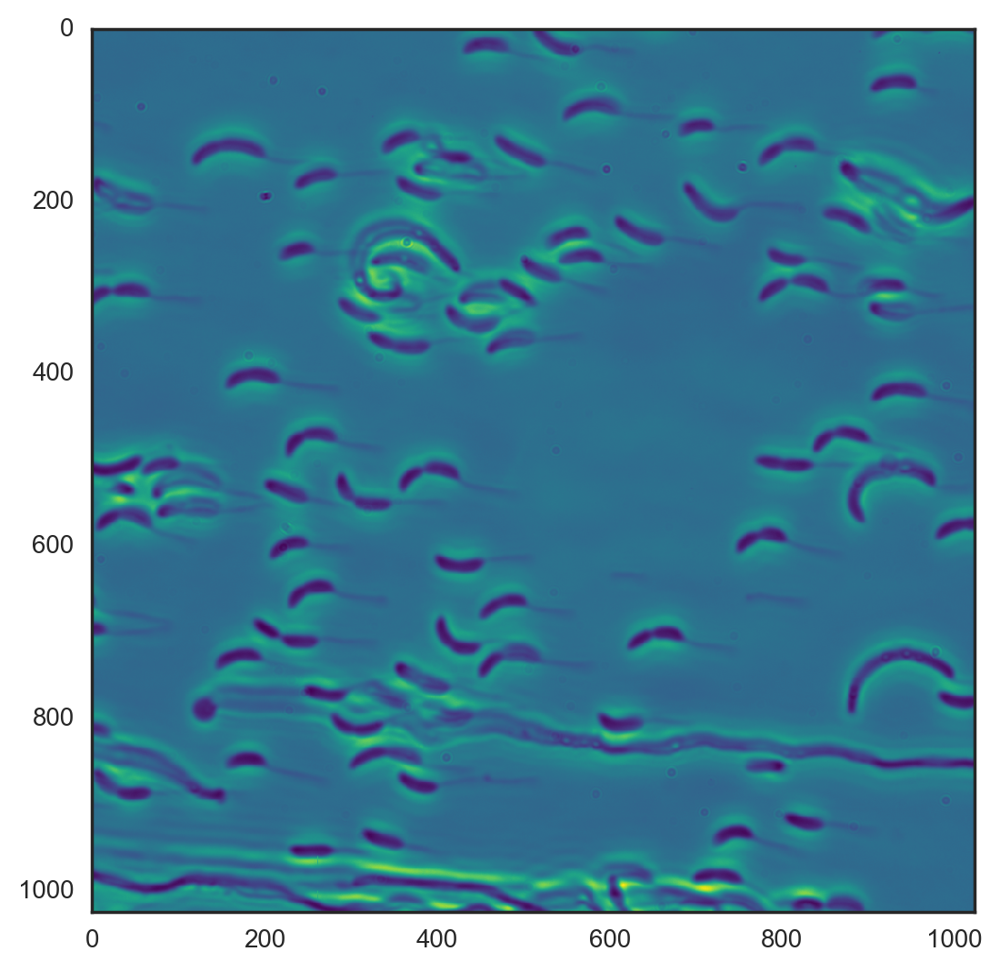

In [7]:
im = ic_sequential_full_field[0]

# Convert image to float
im_float = (im.astype(float) - im.min()) / (im.max() - im.min())

with sns.axes_style('white'):
    skimage.io.imshow(im_float, cmap=plt.cm.viridis)

This is the full field of the bacteria. To choose bacteria to follow over time, **we should pick bacteria that are isolated**. We don't want bacteria that have other bacteria in their field of view, since that may interfere with the bacterial area calculations after segmentation. There are also long streaks that may be turbulence in the media or crap in the media. Either way, we should pick bacteria away from these. 

We want to check how many channels *im* has

In [8]:
# What data type?
print('Data type:', im.dtype)

# What shape
print('Shape:', im.shape)

Data type: uint16
Shape: (1024, 1024)


The image only has data from one channel in a 1024x1024 ndarray. We can now explore multiple methods to segment our images. 

### Method 1: Segmenting using the Otsu Threshold

We can plot a histogram of the pixels in *im*. We can also plot the value derived from using the otsu thresholding method. 

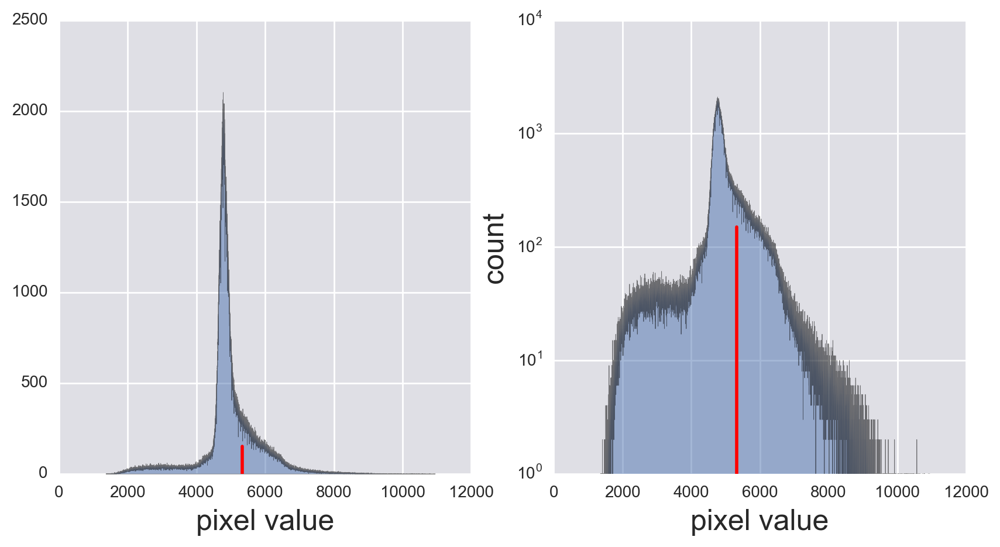

In [9]:
# Get the histogram data
hist_ff_1, bins_ff_1 = skimage.exposure.histogram(im)
thresh_otsu = skimage.filters.threshold_otsu(im)

# Display histograms with log scale
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].fill_between(bins_ff_1, hist_ff_1, alpha=0.5)
ax[0].plot([thresh_otsu, thresh_otsu], [0, 150], 'r-')
ax[0].set_xlabel('pixel value')
ax[1].fill_between(bins_ff_1, hist_ff_1, alpha=0.5)
ax[1].plot([thresh_otsu, thresh_otsu], [0, 150], 'r-')
ax[1].set_yscale('log')

# Label axes
plt.xlabel('pixel value')
plt.ylabel('count');

We compute a threshold using the otsu threshold. We're trying to find the pixel value which can help us define the background. However, this method isn't as effective because there isn't as clear of a distinction between the bacteria and the background, as we had hoped. This leads to rather awful segmentation, as shown below.

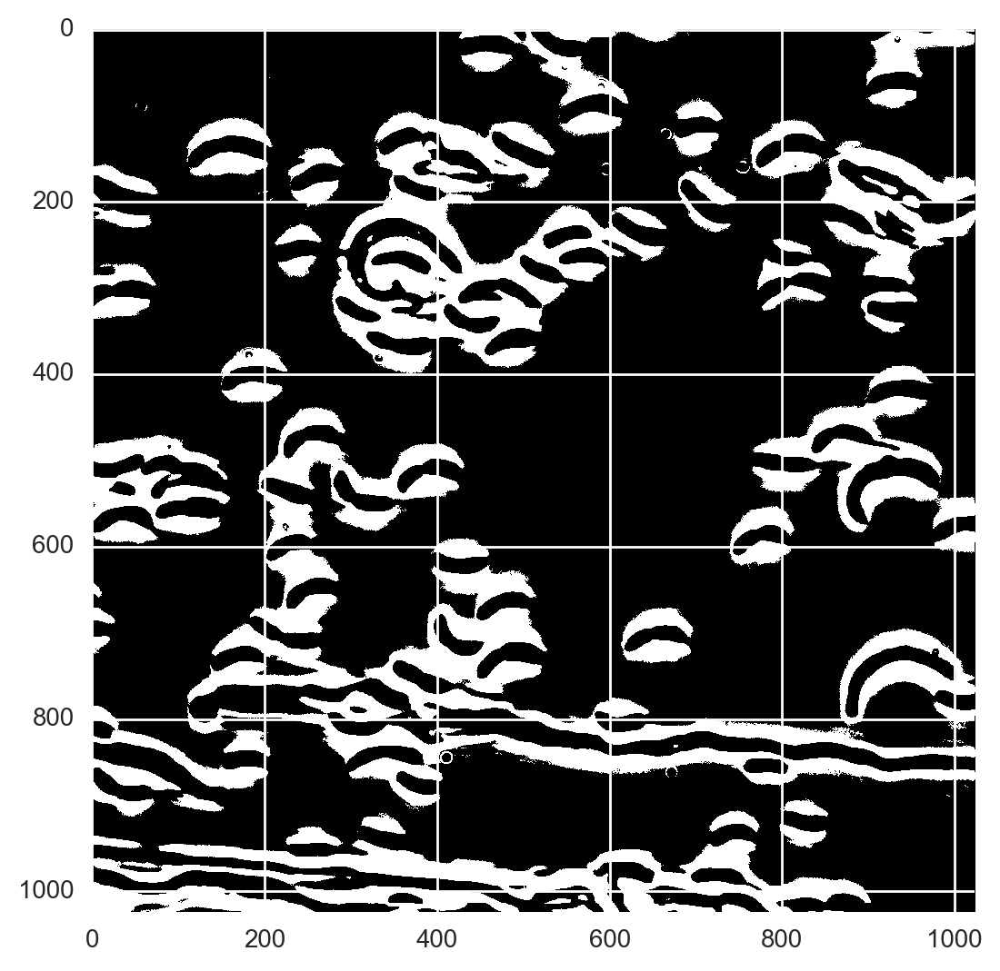

In [10]:
im_seg_otsu = im > thresh_otsu
skimage.io.imshow(im_seg_otsu)

### Method 2: Segmenting using bebi103_thresh

Another method we can try is defined in the *bebi103_thresh*. In addition, to ease the segmentation, we filter the image by smoothing with a mean filter. 

In [11]:
def bebi103_thresh(im, selem, white_true=True, k_range=(0.5, 1.5), 
                   min_size=100):
    """
    Threshold image as described above.  Morphological mean filter is 
    applied using selem.
    """    
    # Determine comparison operator
    if white_true:
        compare = np.greater
        sign = -1
    else:
        compare = np.less
        sign = 1
    
    # Do the mean filter
    im_mean = skimage.filters.rank.mean(im, selem)

    # Compute number of pixels in binary image as a function of k
    k = np.linspace(k_range[0], k_range[1], 100)
    n_pix = np.empty_like(k)
    for i in range(len(k)):
        n_pix[i] = compare(im, k[i] * im_mean).sum() 

    # Compute rough second derivative
    dn_pix_dk2 = np.diff(np.diff(n_pix))

    # Find index of maximal second derivative
    max_ind = np.argmax(sign * dn_pix_dk2)

    # Use this index to set k
    k_opt = k[max_ind - sign * 2]

    # Threshold with this k
    im_bw = compare(im, k_opt * im_mean)

    # Remove all the small objects
    im_bw = skimage.morphology.remove_small_objects(im_bw, min_size=min_size)
    
    # Fill holes
    im_bw_filled = scipy.ndimage.morphology.binary_fill_holes(im_bw)
    
   
    return im_bw_filled, k_opt

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


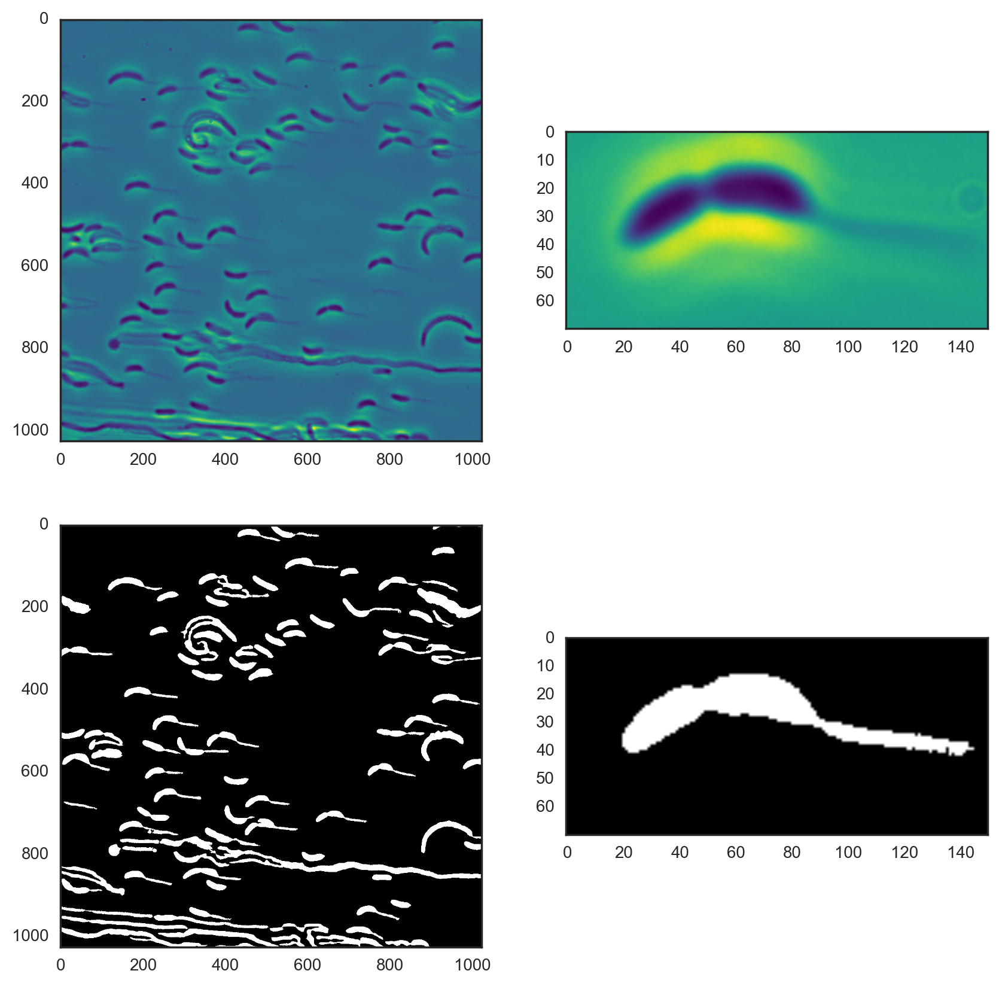

In [12]:
# Make the structuring element 5 pixel radius disk
selem_2 = skimage.morphology.disk(10)

# Threshhold based on mean filter
im_bw, k = bebi103_thresh(im, selem_2, white_true=False, min_size=400)

# Get convenient slide
zoom = np.s_[680:750, 600:750]

with sns.axes_style('white'):
    fig, ax = plt.subplots(2, 2, figsize=(10,10))
    ax[0, 0].imshow(im, cmap=plt.cm.viridis)
    ax[0, 1].imshow(im[zoom], cmap=plt.cm.viridis)
    ax[1, 0].imshow(im_bw, cmap=plt.cm.gray)
    ax[1, 1].imshow(im_bw[zoom], cmap=plt.cm.gray)

This is pretty good segmention. We see that we have included the stalk in our bacterial area as well. As long as we consistently include the stalk, this should be fine. This just slightly shifts our bacterial area upward. 

At this point, we can find 4 isolated bacteria in this image and see how they have segmented. If they have segmented well, we can follow them over time. 

These ROIs were found using plt.ginput().


In [380]:
bac_1_verts  = [(607.32562979474187, 680.85785168564723),
 (695.78005729758047, 678.40078425501281),
 (700.69419215884932, 727.54213286770096),
 (607.32562979474187, 729.99920029833538)]

bac_2_verts = [(720.35073160392471, 565.37568244582997),
 (823.54756369056986, 561.69008129987833),
 (826.00463112120428, 618.20263220446986),
 (727.72193389582776, 618.20263220446986)]


bac_3_verts = [(128.19748082103183, 373.724422856346),
 (243.6796500608491, 379.86709143293206),
 (252.27938606806958, 435.15110862220627),
 (136.79721682825232, 437.60817605284069)]

bac_4_verts = [(200.6809700247469, 634.17357050359351),
 (303.87780211139216, 620.65969963510418),
 (302.64926839607494, 672.25811567842675),
 (210.5092397472846, 679.62931797033002)]

In [384]:
# Bacteria 1
roi_1, roi_bbox_1, roi_1 = bebi103.verts_to_roi(bac_1_verts, *im.shape)

# Bacteria 2
roi_2, roi_bbox_2, roi_2 = bebi103.verts_to_roi(bac_2_verts, *im.shape)

# Bacteria 3
roi_3, roi_bbox_3, roi_3 = bebi103.verts_to_roi(bac_3_verts, *im.shape)

# Bacteria 4
roi_4, roi_bbox_4, roi_4 = bebi103.verts_to_roi(bac_4_verts, *im.shape)

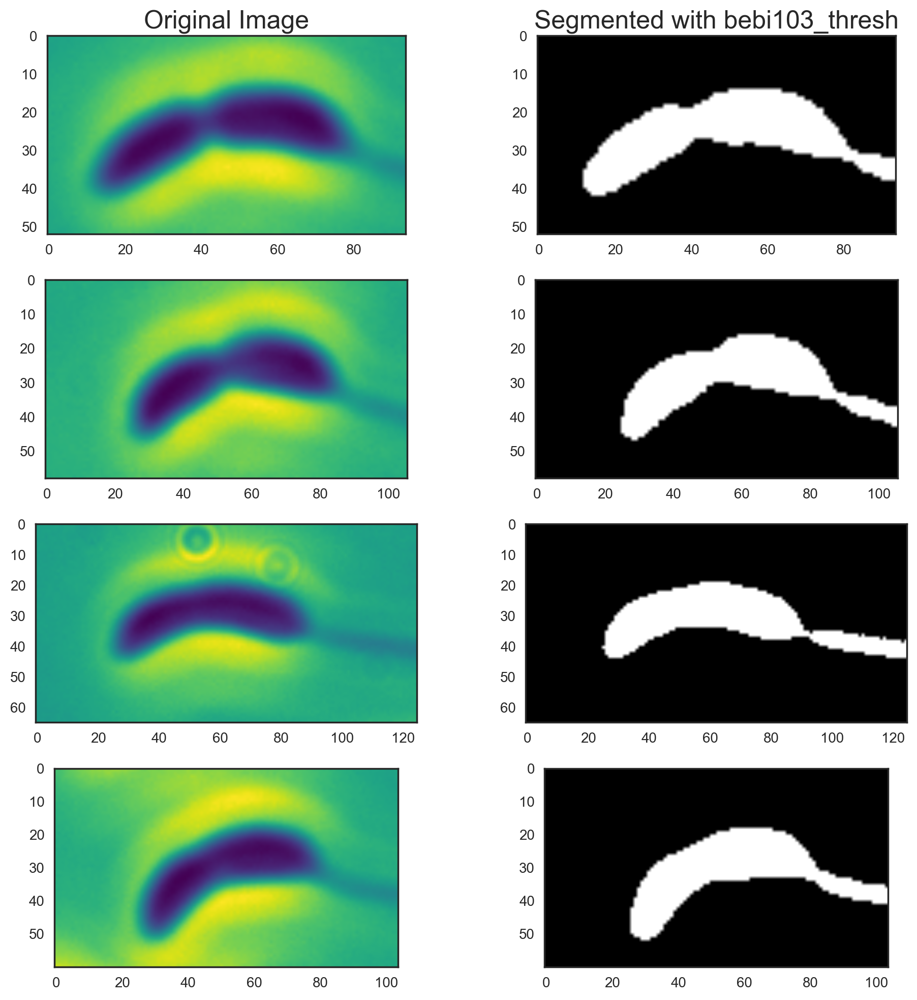

In [383]:
with sns.axes_style('white'):
    fig, ax = plt.subplots(4, 2, figsize=(10, 10))
    ax[0,0].set_title('Original Image')
    ax[0,1].set_title('Segmented with bebi103_thresh')
    ax[0,0].imshow(im[roi_bbox_1], cmap=plt.cm.viridis)
    ax[0,1].imshow(im_bw[roi_bbox_1], cmap=plt.cm.gray)
    ax[1,0].imshow(im[roi_bbox_2], cmap=plt.cm.viridis)
    ax[1,1].imshow(im_bw[roi_bbox_2], cmap=plt.cm.gray)
    ax[2,0].imshow(im[roi_bbox_3], cmap=plt.cm.viridis)
    ax[2,1].imshow(im_bw[roi_bbox_3], cmap=plt.cm.gray)
    ax[3,0].imshow(im[roi_bbox_4], cmap=plt.cm.viridis)
    ax[3,1].imshow(im_bw[roi_bbox_4], cmap=plt.cm.gray)

plt.tight_layout()

These have segmented pretty well! It seems like we can use *bebi103_thresh* through the rest of the problem. Until then, we can explore other segmentation methods. 



### Method 3: Using Laplacian of Gaussian and zero crossing

While I tried using laplacian og gaussian and then using zero crossing to detect edges, this method was not successful because I couldn't find the correct parameters such that I could threshold out the zero-crossing in the background and successfully close the skeletonized image. The images shown below illustrate the best I could do. 

Regardless, since this method took a lot of experimentation, it isn't ideal for segmenting a large collection of images, because we could have different parameters for each picture, but we don't have a luxury of sorting through to see if it worked. Since it's so unreliable for these images, this segmentation method isn't ideal for this case. 

In addition, it inconsistently segments the stalks of the bacteria (i.e. sometimes it's included, sometimes it is not). We should use a more reliable and consistent method like bebi103_thresh

In [386]:
def zero_crossing_filter(im, thresh):
    """
    Returns image with 1 if there is a zero crossing and 0 otherwise.
    
    thresh is the the minimal value of the gradient, as computed by Sobel
    filter, at crossing to count as a crossing.
    """
    # Square structuring element
    selem = skimage.morphology.square(3)
    
    # Do max filter and min filter
    im_max = scipy.ndimage.filters.maximum_filter(im, footprint=selem)
    im_min = scipy.ndimage.filters.minimum_filter(im, footprint=selem)
    
    # Compute gradients using Sobel filter
    im_grad = skimage.filters.sobel(im)
    
    # Return edges
    return (((im >= 0) & (im_min < 0)) | ((im <= 0) & (im_max > 0))) \
                & (im_grad >= thresh)

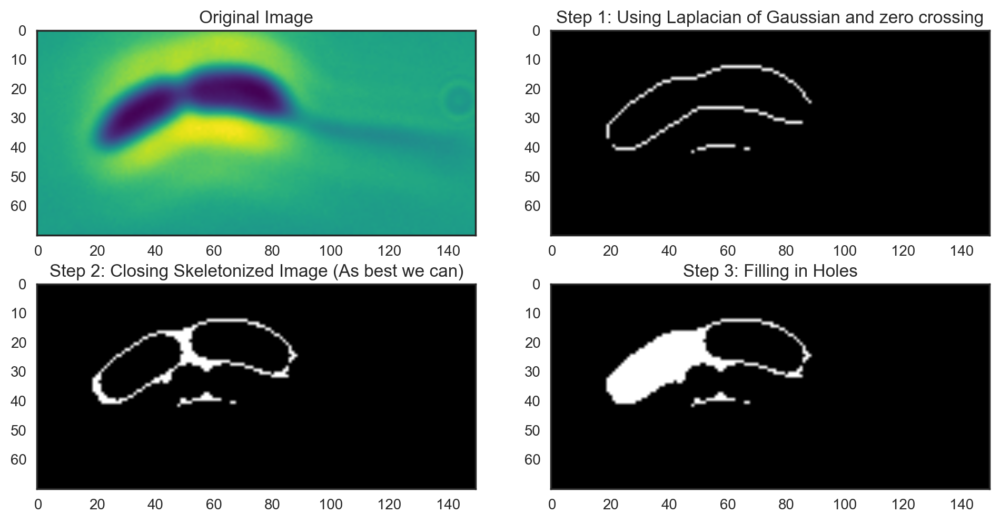

In [406]:
# Compute LoG
im_LoG = scipy.ndimage.filters.gaussian_laplace(im_no_bg, 5.0)

# Find zero-crossings
im_edge = zero_crossing_filter(im_LoG, 0.001)

# Skeletonize edges
im_edge = skimage.morphology.skeletonize(im_edge)

# Close the edge image

selem = skimage.morphology.disk(6)
im_edge_closed = skimage.morphology.binary_closing(im_edge, selem)

# Fill holes
im_bw_filled = scipy.ndimage.morphology.binary_fill_holes(im_edge_closed)

with sns.axes_style('white'):
    fig, ax = plt.subplots(2, 2, figsize=(10,5))
    ax[0, 0].imshow(im[zoom], cmap=plt.cm.viridis)
    ax[0, 0].set_title('Original Image', size=12)
    ax[0, 1].imshow(im_edge[zoom], cmap=plt.cm.gray)
    ax[0, 1].set_title('Step 1: Using Laplacian of Gaussian and zero crossing', size=12)
    ax[1, 0].imshow(im_edge_closed[zoom],cmap=plt.cm.gray )
    ax[1, 0].set_title('Step 2: Closing Skeletonized Image (As best we can)',size=12 )
    ax[1, 1].imshow(im_bw_filled[zoom],cmap=plt.cm.gray )
    ax[1, 1].set_title('Step 3: Filling in Holes',size=12 )
plt.tight_layout()

We see that since we haven't completely closed the image, we can't use it to fill in the hole. 

### Method 4: Canny Edge Detection. 

This method is shown below. 

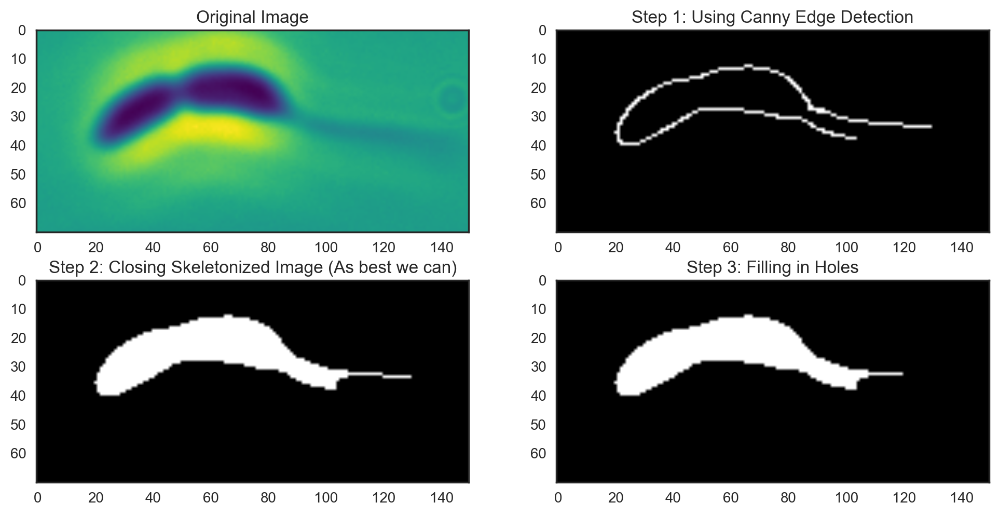

In [417]:
# Do Canny edge detection on image, use sigma = 1.4
im_edge_2 = skimage.feature.canny(im_float, 1.4)
selem_3 = skimage.morphology.disk(5)
im_edge_closed_2 = skimage.morphology.binary_closing(im_edge_2, selem_3)

# Fill holes
im_bw_filled_2 = scipy.ndimage.morphology.binary_fill_holes(im_edge_closed_2)

# Remove small objectes that are not bacteria
im_bw_2 = skimage.morphology.remove_small_objects(im_bw_filled_2, min_size=100)


# Show image
with sns.axes_style('white'):
    fig, ax = plt.subplots(2, 2, figsize=(10,5))
    ax[0,0].imshow(im[zoom], cmap=plt.cm.viridis)
    ax[0,1].imshow(im_edge_2[zoom], cmap=plt.cm.gray)
    ax[1,0].imshow(im_bw_filled_2[zoom], cmap=plt.cm.gray)
    ax[1,1].imshow(im_bw_2[zoom], cmap=plt.cm.gray)
    
    ax[0, 0].set_title('Original Image', size=12)
    ax[0, 1].set_title('Step 1: Using Canny Edge Detection', size=12)
    ax[1, 0].set_title('Step 2: Closing Skeletonized Image (As best we can)',size=12 )
    ax[1, 1].set_title('Step 3: Filling in Holes',size=12 )
    plt.tight_layout()

Again, while we capture the edges (or the overall shape of the bacteria) very well, we have trouble closing the image. Thus, it is much easier to just use *bebi103_thresh* since it is reliable and consistently includes the stalk. 

The final 4 bacteria I chose were shown above when I discussed *bebi103_thresh*. To reiterate, I chose these bacteria because they were isolated and thus would create minimal errors in segmentation. 

** (b) The files bacterium_1.tif and bacterium_2.tif are TIFF stacks of time courses for specific cells in from the full field images. From these time courses, compute the time scale of division of the cells. In other words, compute the time between divisions for each division for each cell and plot the results. Comment on any interesting aspects of these data.**

## Segmenting the Images

We can begin by loading the TIFF stacks

In [418]:
dir_bac_1 = '../data/iyer_biswas_et_al/bacterium_1.tif'
ic_bac_1 = skimage.io.imread(dir_bac_1)

dir_bac_2 = '../data/iyer_biswas_et_al/bacterium_2.tif'
ic_bac_2 = skimage.io.imread(dir_bac_2)

# Interframe time
dt = 1  # minutes

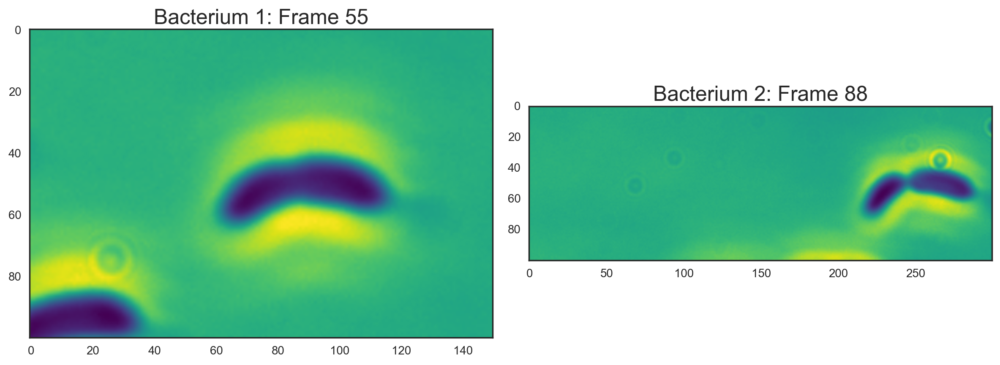

In [420]:
im_bac_1 = ic_bac_1[55]
im_bac_2 = ic_bac_2[88]

with sns.axes_style('white'):
    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    ax[0].imshow(im_bac_1, cmap=plt.cm.viridis)
    ax[1].imshow(im_bac_2, cmap=plt.cm.viridis)
    ax[0].set_title('Bacterium 1: Frame 55')
    ax[1].set_title('Bacterium 2: Frame 88')
    plt.tight_layout()

We see that we have a random bacterium in the corner in the Bacterium 1 movie. This will add to our area, so we can remove this bacterium by using the clear border function. However, we have to be careful because bacterium 2 is already pretty close to the edge. We have to be careful before using the clear_border function here because we may accidentally clear the entire bacterium. So, we can update the *bebi103_thresh* function from before with an argument called *bac_num* which simply indicates which bacterium number we are segmenting. 

The updated function is used below. 

In [421]:
def bebi103_thresh_my_version(im, selem, bac_num, white_true=True, k_range=(0.5, 1.5), 
                   min_size=100):
    """
    Threshold image as described above.  Morphological mean filter is 
    applied using selem.
    """    
    # Determine comparison operator
    if white_true:
        compare = np.greater
        sign = -1
    else:
        compare = np.less
        sign = 1
    
    # Do the mean filter
    im_mean = skimage.filters.rank.mean(im, selem)

    # Compute number of pixels in binary image as a function of k
    k = np.linspace(k_range[0], k_range[1], 100)
    n_pix = np.empty_like(k)
    for i in range(len(k)):
        n_pix[i] = compare(im, k[i] * im_mean).sum() 

    # Compute rough second derivative
    dn_pix_dk2 = np.diff(np.diff(n_pix))

    # Find index of maximal second derivative
    max_ind = np.argmax(sign * dn_pix_dk2)

    # Use this index to set k
    k_opt = k[max_ind - sign * 2]

    # Threshold with this k
    im_bw = compare(im, k_opt * im_mean)

    # Remove all the small objects
    im_bw = skimage.morphology.remove_small_objects(im_bw, min_size=min_size)
    

    # we can clear the border for the first bacteria to get rid of the bacteria in the corner of the frame
    if bac_num == 1:
        im_bw = skimage.segmentation.clear_border(im_bw, buffer_size=5)
   
    return im_bw, k_opt

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


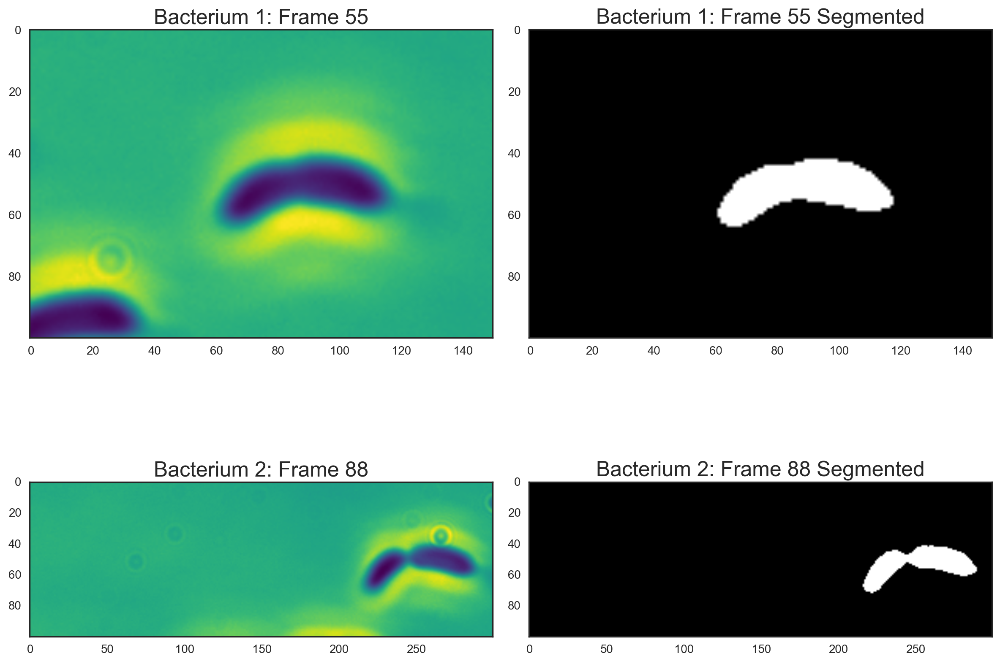

In [428]:

im_bac_1_bw, k = bebi103_thresh_my_version(im_bac_1, selem_2, 1, white_true=False, min_size=400)
im_bac_2_bw, k = bebi103_thresh_my_version(im_bac_2, selem_2, 2, white_true=False, min_size=400)

with sns.axes_style('white'):
    fig, ax = plt.subplots(2, 2, figsize=(12, 10))
    ax[0, 0].imshow(im_bac_1, cmap=plt.cm.viridis)
    ax[0, 1].imshow(im_bac_1_bw, cmap=plt.cm.gray)
    ax[0, 0].set_title('Bacterium 1: Frame 55')
    ax[0, 1].set_title('Bacterium 1: Frame 55 Segmented')
    ax[1, 0].imshow(im_bac_2, cmap=plt.cm.viridis)
    ax[1, 1].imshow(im_bac_2_bw, cmap=plt.cm.gray)
    ax[1, 0].set_title('Bacterium 2: Frame 88')
    ax[1, 1].set_title('Bacterium 2: Frame 88 Segmented')
    plt.tight_layout()


<div class="alert alert-info">
Good. Score: 10/10
</div> 

Now that we have demonstrated that our segmentation technique worked (it cleared the bacteria and the border and everything), we can proceed to write a function that calculates the bacterial area in each frame of an image collection. 

In [429]:
def find_bacterial_area(ic, bac_num):
    bacterial_areas = []
    for i in range(len(ic)):
        im = ic[i]
        im_filt, k = bebi103_thresh_my_version(im, selem_2, bac_num, white_true=False, min_size=100)

        bacterial_area_pix = im_filt.sum()

        # Define interpixel distance
        interpix_dist = 0.052  # microns

        # Compute bacterial area in square microns and add to the list of bacterial_areas. 
        bacterial_area_micron = bacterial_area_pix * interpix_dist**2
        bacterial_areas.append(bacterial_area_micron)

    return np.array(bacterial_areas)

In [430]:
bac_1_intensities = find_bacterial_area(ic_bac_1, 1)
bac_1_intensities

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)
C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


array([ 2.536352,  1.430416,  1.441232, ...,  2.833792,  2.855424,
        2.863536])

We plot our results below. 



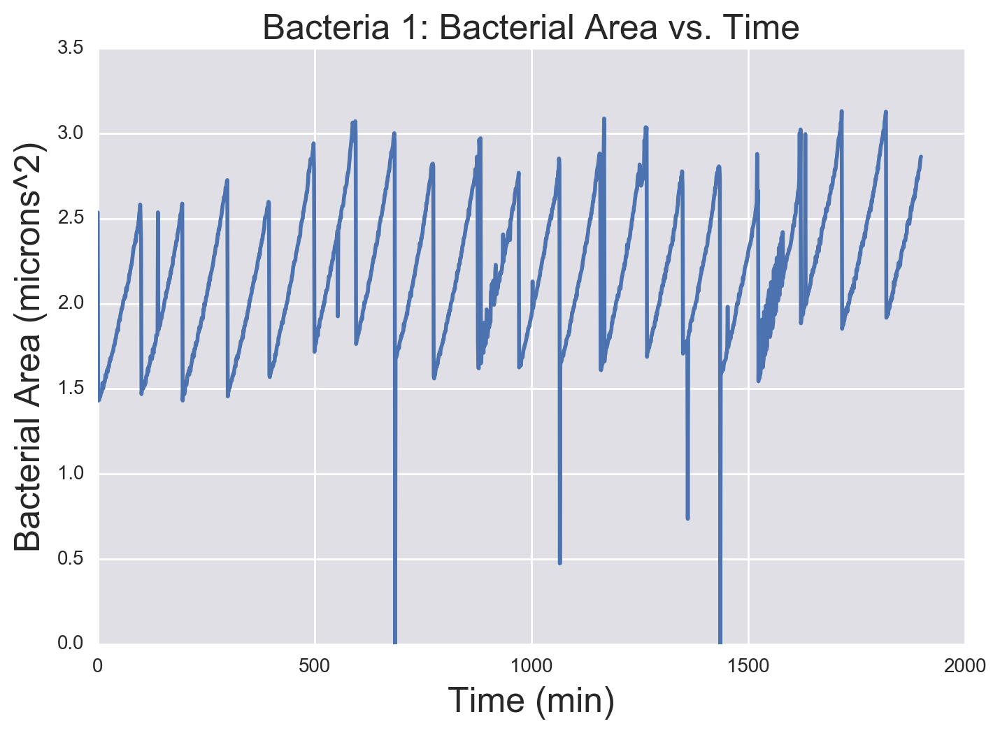

In [432]:
plt.plot(bac_1_intensities)
plt.title('Bacteria 1: Bacterial Area vs. Time')
plt.ylabel('Bacterial Area (microns^2)')
plt.xlabel('Time (min)')

Yikes! It doesn't seem like our segmentation worked as well as we had hoped. 

We will follow the following troubleshooting pipeline.
1. Remove any blurry frames
2. Figure out what the giant dips in intensity are. (Spoiler alert: these are bacteria that touch the edge. )
3. We'll remove 'bad frames' or frames where random debris float through our ROI. These show up as random spikes in intensity. 


### Step 1: Remove Blurry Frames

We can plot the coefficient of variations of the frames to find potentially blurry frames. We look for drops in the coefficient of variation since blurry frames don't have much variation. 

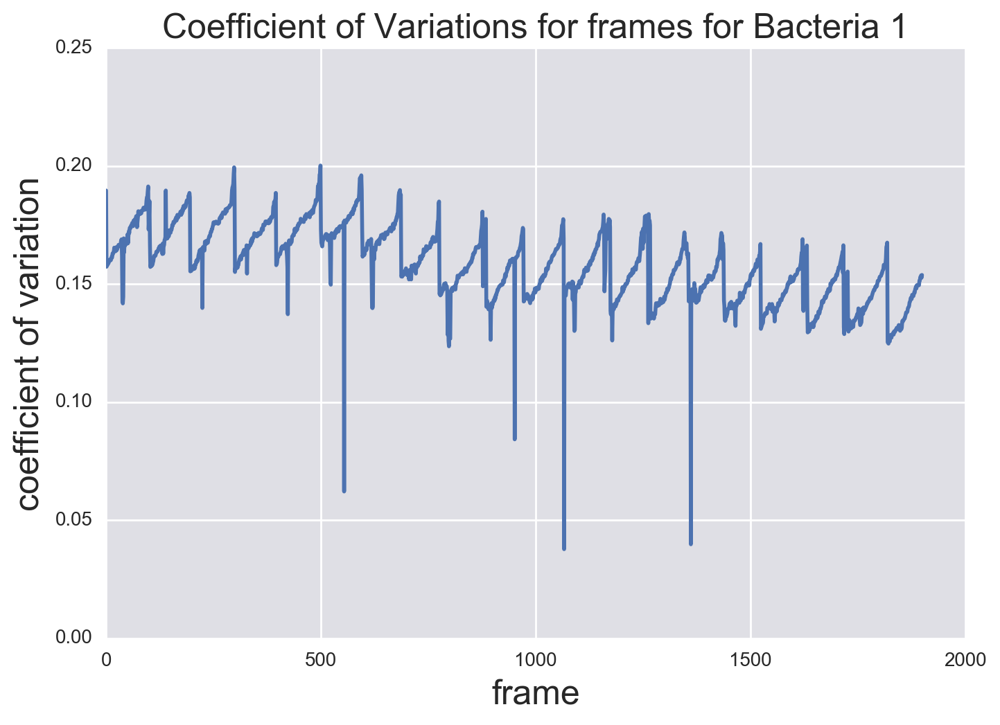

In [434]:
covs_bac_1 = np.array([im.std() / im.mean() for im in ic_bac_1])

plt.plot(covs_bac_1)
plt.xlabel('frame')
plt.ylabel('coefficient of variation');
plt.title("Coefficient of Variations for frames for Bacteria 1")
plt.figure()

Let's find where these blurry frames are by thresholding them out and looking to see what happened. 

In [435]:
np.where(covs_bac_1<0.1)[0]

array([ 554,  951, 1066, 1361], dtype=int64)

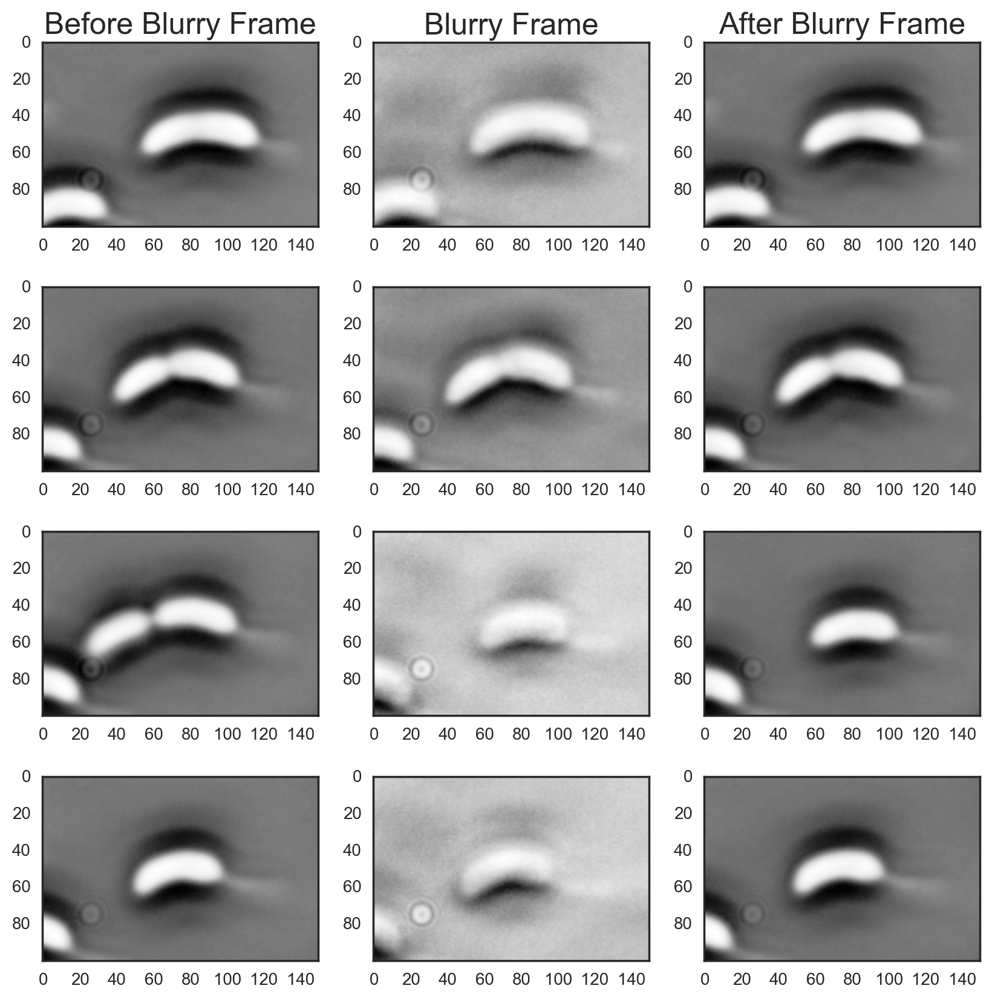

In [436]:
inds_bad_frames_bac_1 = np.where(covs_bac_1<0.1)[0]
with sns.axes_style('white'):
    fig, ax = plt.subplots(4, 3, figsize=(10, 10))
    ax[(0,0)].set_title('Before Blurry Frame')
    ax[(0,1)].set_title('Blurry Frame')
    ax[(0,2)].set_title('After Blurry Frame')
    for i, frame in enumerate(inds_bad_frames_bac_1):
        ax[(i,0)].imshow(ic_bac_1[frame-1])
        ax[(i,1)].imshow(ic_bac_1[frame])
        ax[(i,2)].imshow(ic_bac_1[frame+1])



We see that indeed, at these frames, the camera goes briefly out of focus. Perhaps these frames are affecting our segmentation.

We remove these blurry images from our image as follows. We define a threshold for the coefficients of variation and use that to threshold the images. 

We determined these thresholds by eye: 0.1 for bac 1 and 0.07 for bac 2 (which we will threshold later). 

In [67]:
good_frames_bac_1 = [i for i in range(len(ic_bac_1)) if covs_bac_1[i] > 0.1]
bad_frames_bac_1 = [i for i in range(len(ic_bac_1)) if covs_bac_1[i] < 0.1]
ic_bac_1_fixed = [ic_bac_1[i] for i in good_frames_bac_1]
ic_bac_1_bad = [ic_bac_1[i] for i in bad_frames_bac_1]

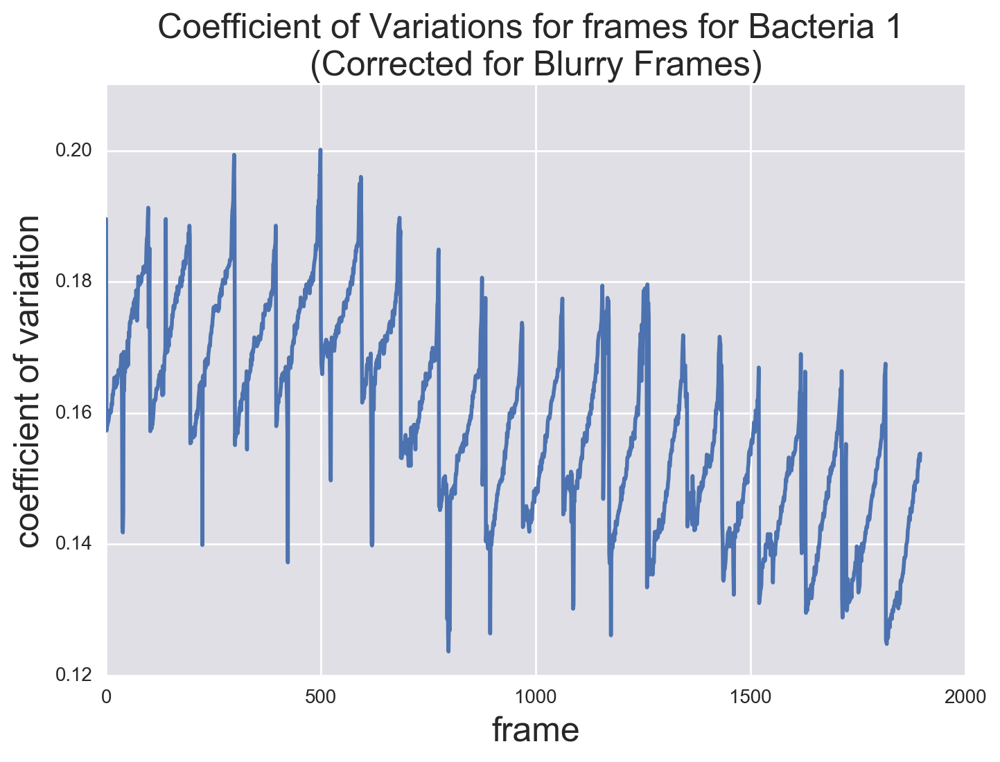

In [437]:
covs_bac_1_fixed = np.array([im.std() / im.mean() for im in ic_bac_1_fixed])

plt.plot(covs_bac_1_fixed)
plt.xlabel('frame')
plt.ylabel('coefficient of variation');
plt.title("Coefficient of Variations for frames for Bacteria 1 \n(Corrected for Blurry Frames)")
plt.figure()



We have removed the blurry frames! We don't have any more dips in the covariance skewing our coefficient of variations graph

Let's see if removing the blurry frames fixed our issues with the bacterial areas

In [438]:
bac_1_intensities_fixed = find_bacterial_area(ic_bac_1_fixed, 1)
bac_1_intensities_fixed

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)
C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


array([ 2.536352,  1.430416,  1.441232, ...,  2.833792,  2.855424,
        2.863536])

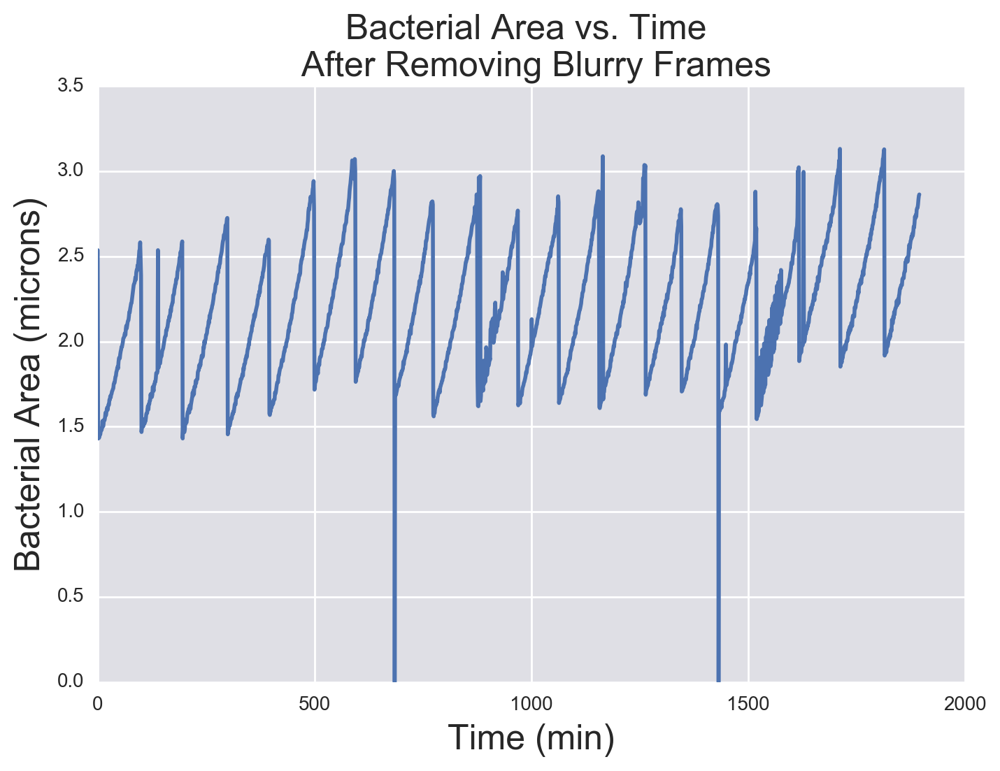

In [439]:
plt.plot(bac_1_intensities_fixed)
plt.title('Bacterial Area vs. Time \n After Removing Blurry Frames')
plt.ylabel('Bacterial Area (microns)')
plt.xlabel('Time (min)')

### Step 2: Removing Dips in the Intensity. 

Removing the blurry frames didn't seem to solve the problem. Let's look to see what actually happened at the frames where we have these dips in intensity)

In [440]:
np.where(bac_1_intensities_fixed == 0.0)

(array([ 685, 1432], dtype=int64),)

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


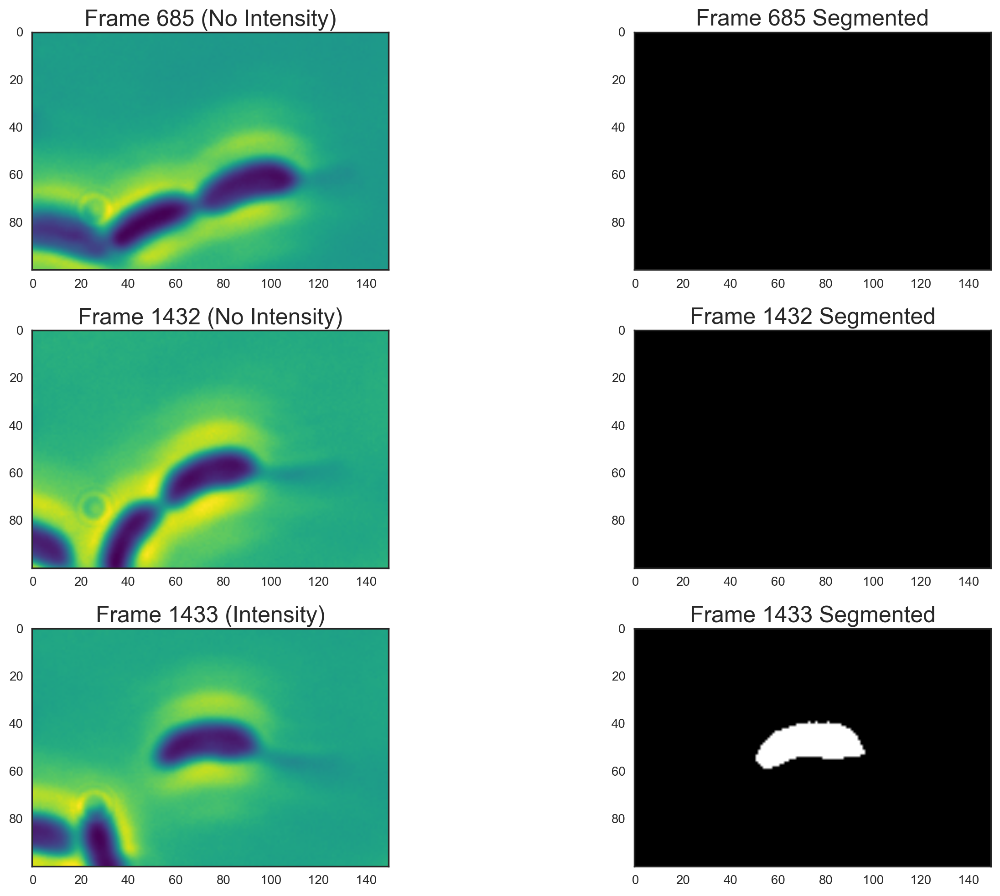

In [441]:
frame_685 = ic_bac_1_fixed[685]
frame_685_bebithresh, k_685 = bebi103_thresh_my_version(ic_bac_1_fixed[685], selem_2, 1, white_true=False, min_size=400)

frame_1432 = ic_bac_1_fixed[1432]
frame_1432_bebithresh, k_1432 = bebi103_thresh_my_version(ic_bac_1_fixed[1432], selem_2, 1, white_true=False, min_size=400)

frame_1433 = ic_bac_1_fixed[1433]
frame_1433_bebithresh, k_1433 = bebi103_thresh_my_version(ic_bac_1_fixed[1433], selem_2, 1, white_true=False, min_size=400)


with sns.axes_style('white'):
    fig, ax = plt.subplots(3, 2, figsize=(15, 10))
    #for i in range(len(ic_bac_1_bad)):
    sps = [(0,0), (0,1), (1,0), (1,1)]
    ax[(0,0)].imshow(frame_685, cmap=plt.cm.viridis)
    ax[(0,1)].imshow(frame_685_bebithresh, cmap=plt.cm.gray)
    ax[(0,0)].set_title("Frame 685 (No Intensity)")
    ax[(0,1)].set_title("Frame 685 Segmented")
    
    ax[(1,0)].imshow(frame_1432, cmap=plt.cm.viridis)
    ax[(1,1)].imshow(frame_1432_bebithresh,  cmap=plt.cm.gray)
    ax[(1,0)].set_title("Frame 1432 (No Intensity)")
    ax[(1,1)].set_title("Frame 1432 Segmented")
    
    ax[(2,0)].imshow(frame_1433, cmap=plt.cm.viridis)
    ax[(2,1)].imshow(frame_1433_bebithresh,  cmap=plt.cm.gray)
    ax[(2,0)].set_title("Frame 1433 (Intensity)")
    ax[(2,1)].set_title("Frame 1433 Segmented")   
fig.tight_layout()

Ah ha! We see that something went wrong with our segmentation in these frames. 

In Frame 685, it seems like the dividing bacteria migrated to the point where it touches the bacteria in the corner of the frame. In fact, the overlap between the two probably means all 3 bacteria segmented as a single region. Since this region  touches the edge,  the clear_edges function removes it, leaving us with the black frame we see above. Along the same lines, in Frame 1432, the dividing bacteria itself has moved so that it is out of the frame, and then gets cleared because it is at the edge. So, we can deal with these frames by just removing them from our analysis as shown below. 

In [442]:
gf_bac_1 = [i for i in range(len(ic_bac_1_fixed)) if bac_1_intensities_fixed[i] != 0.0]
ic_bac_1_fixed_2 = [ic_bac_1_fixed[i] for i in gf_bac_1]

In [443]:
bac_1_intensities_fixed_2 = find_bacterial_area(ic_bac_1_fixed_2, 1)
bac_1_intensities_fixed_2

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)
C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


array([ 2.536352,  1.430416,  1.441232, ...,  2.833792,  2.855424,
        2.863536])

Let's look at the bacterial area over time. 

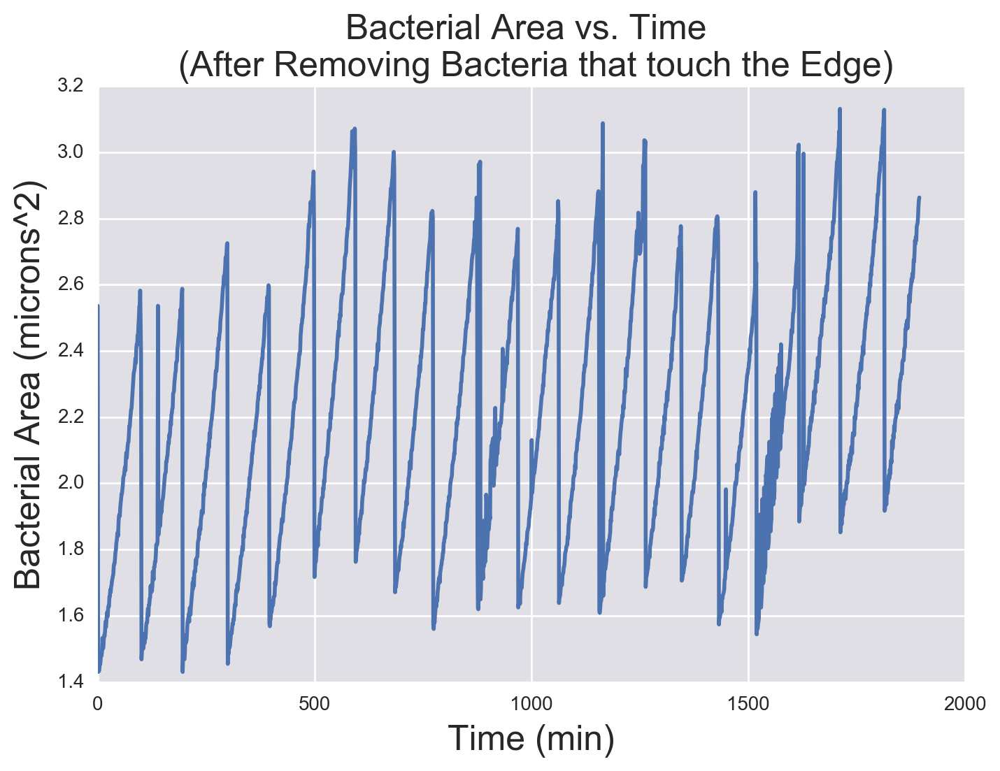

In [451]:
t_bac_1 = (np.array(gf_bac_1, dtype=np.float) - gf_bac_1[0]) * dt

plt.plot(t_bac_1, bac_1_intensities_fixed_2)

plt.title('Bacterial Area vs. Time \n (After Removing Bacteria that touch the Edge)')
plt.ylabel('Bacterial Area (microns^2)')
plt.xlabel('Time (min)')

### Step 3: Figuring out what the random spikes in intensity are

We see that we have a random spike in the middle of a growth division at around 100-150 min. Let's try to isolate it. 

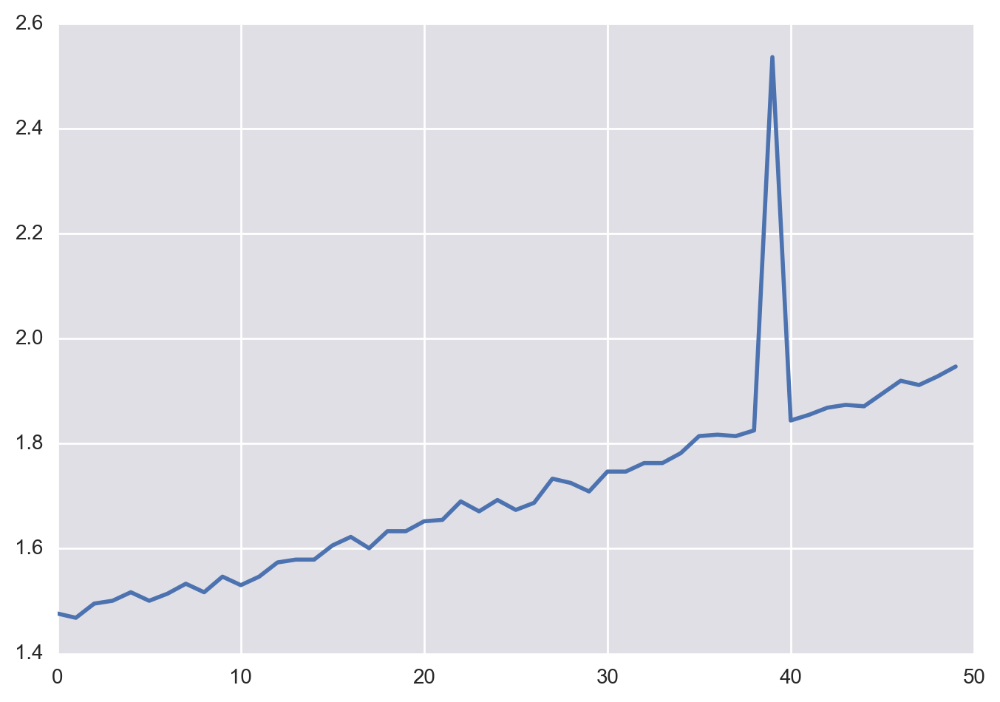

In [49]:
plt.plot(bac_1_intensities_fixed_2[100:150])

In [77]:
np.where(bac_1_intensities_fixed_2[100:150] > 2.0)

(array([ 0, 39], dtype=int64),)

It's apparently at Frame 139. 

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


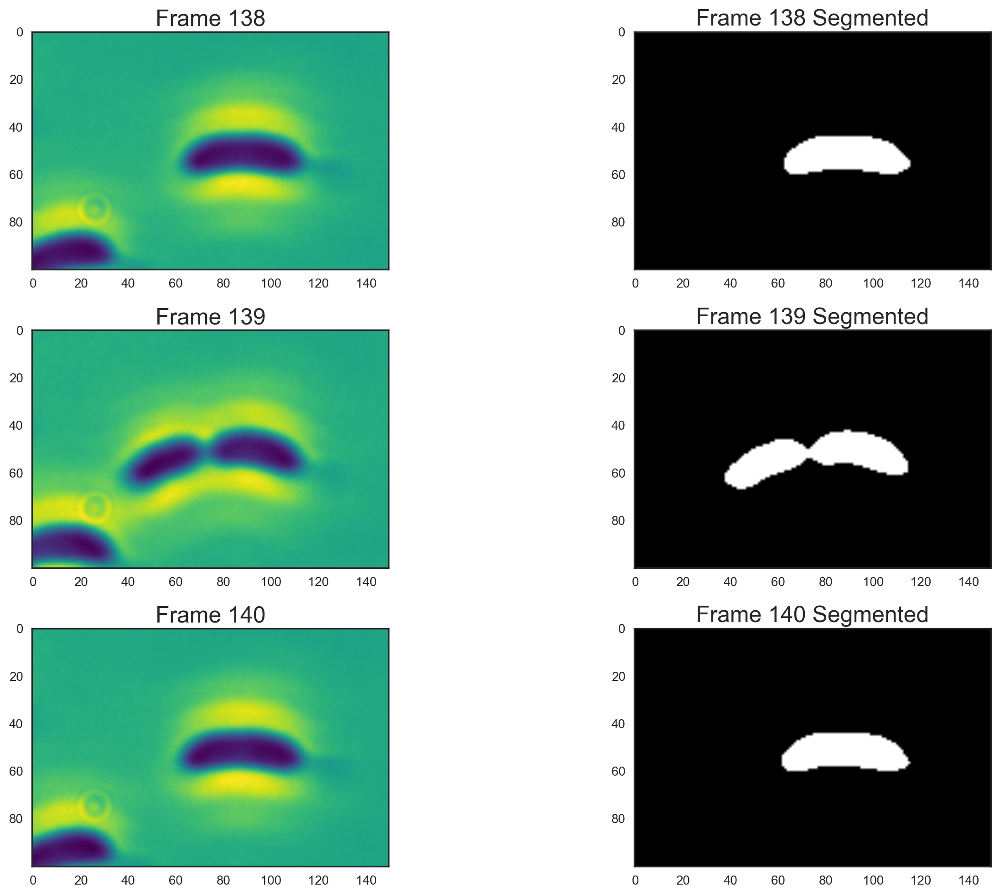

In [79]:
frame_138 = ic_bac_1_fixed_2[138]
frame_138_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[138], selem_2, 1, white_true=False, min_size=400)

frame_139 = ic_bac_1_fixed_2[139]
frame_139_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[139], selem_2, 1, white_true=False, min_size=400)

frame_140 = ic_bac_1_fixed_2[140]
frame_140_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[140], selem_2, 1, white_true=False, min_size=400)


with sns.axes_style('white'):
    fig, ax = plt.subplots(3, 2, figsize=(15, 10))
    ax[(0,0)].imshow(frame_138, cmap=plt.cm.viridis)
    ax[(0,1)].imshow(frame_138_bebithresh, cmap=plt.cm.gray)
    ax[(0,0)].set_title("Frame 138")
    ax[(0,1)].set_title("Frame 138 Segmented")
    
    ax[(1,0)].imshow(frame_139, cmap=plt.cm.viridis)
    ax[(1,1)].imshow(frame_139_bebithresh,  cmap=plt.cm.gray)
    ax[(1,0)].set_title("Frame 139")
    ax[(1,1)].set_title("Frame 139 Segmented")
    
    ax[(2,0)].imshow(frame_140, cmap=plt.cm.viridis)
    ax[(2,1)].imshow(frame_140_bebithresh,  cmap=plt.cm.gray)
    ax[(2,0)].set_title("Frame 140")
    ax[(2,1)].set_title("Frame 140 Segmented")   
fig.tight_layout()



We see that a random bacteria flows through the frame. We should remove Frame 139 from our analysis. 

We should also figure out what's going on at the random spike at around 1600 min. 

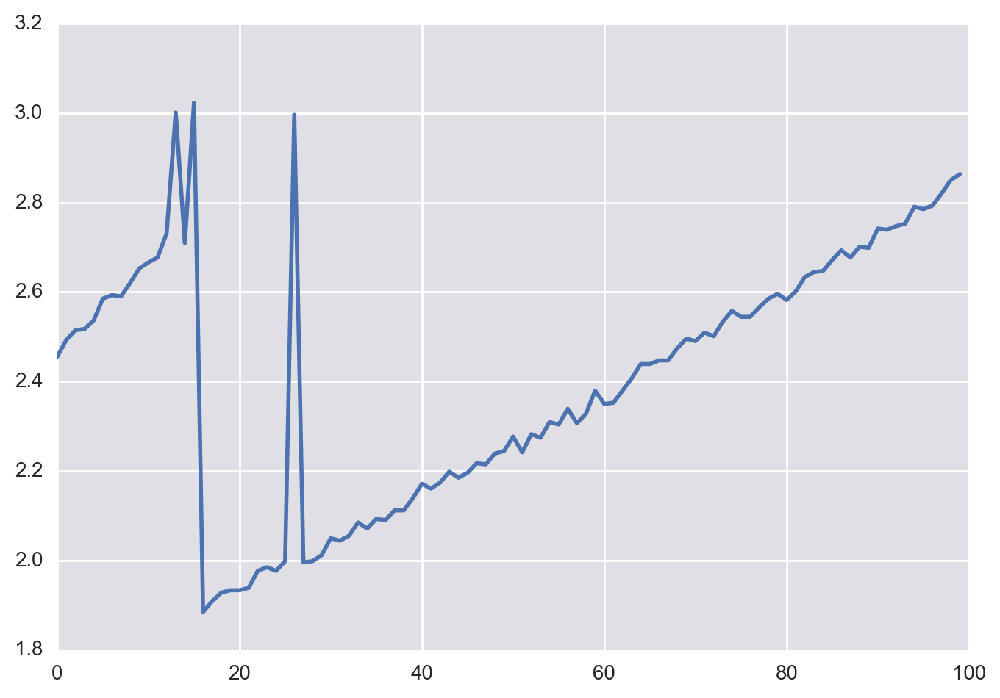

In [445]:
plt.plot(bac_1_intensities_fixed_2[1600:1700])

In [81]:
for i in range(len(bac_1_intensities_fixed_2[1600:1700])-1):
    diff = bac_1_intensities_fixed_2[1600:1700][i+1]- bac_1_intensities_fixed_2[1600:1700][i]
    if diff>0.8:
        print (i+1, diff)


26 0.997776


This is apparently Frame 1626. 

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


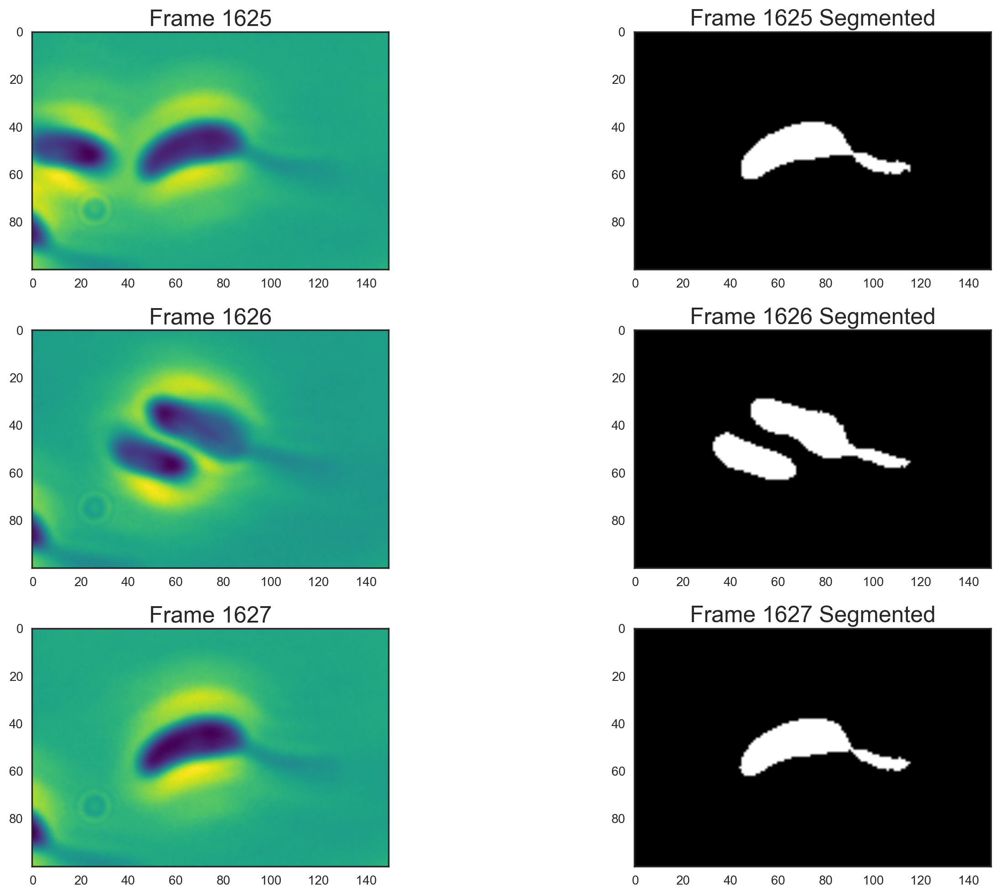

In [446]:
frame_1625 = ic_bac_1_fixed_2[1625]
frame_1625_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[1625], selem_2, 1, white_true=False, min_size=400)

frame_1626 = ic_bac_1_fixed_2[1626]
frame_1626_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[1626], selem_2, 1, white_true=False, min_size=400)

frame_1627 = ic_bac_1_fixed_2[1627]
frame_1627_bebithresh, k_39 = bebi103_thresh_my_version(ic_bac_1_fixed_2[1627], selem_2, 1, white_true=False, min_size=400)


with sns.axes_style('white'):
    fig, ax = plt.subplots(3, 2, figsize=(15, 10))
    ax[(0,0)].imshow(frame_1625, cmap=plt.cm.viridis)
    ax[(0,1)].imshow(frame_1625_bebithresh, cmap=plt.cm.gray)
    ax[(0,0)].set_title("Frame 1625")
    ax[(0,1)].set_title("Frame 1625 Segmented")
    
    ax[(1,0)].imshow(frame_1626, cmap=plt.cm.viridis)
    ax[(1,1)].imshow(frame_1626_bebithresh,  cmap=plt.cm.gray)
    ax[(1,0)].set_title("Frame 1626")
    ax[(1,1)].set_title("Frame 1626 Segmented")
    
    ax[(2,0)].imshow(frame_1627, cmap=plt.cm.viridis)
    ax[(2,1)].imshow(frame_1627_bebithresh,  cmap=plt.cm.gray)
    ax[(2,0)].set_title("Frame 1627")
    ax[(2,1)].set_title("Frame 1627 Segmented")   
fig.tight_layout()


We need to remove Frame 1626 as well. 

While there are definitively other growth divisions that seem noisy, these seem like they could be problems with segmentation (i.e. sometimes the stalk is segmented out). However, since we don't have the luxury (meaning time) to choose how to threshold each image of this movie, we're just going to remove the frames with clear debris, or the bad frames we have found so far. 

In [447]:
bad_frames = [139, 1626]
gf_bac_1_3 = [i for i in range(len(ic_bac_1_fixed_2)) if i not in bad_frames]
ic_bac_1_fixed_3 = [ic_bac_1_fixed_2[i] for i in gf_bac_1_3]


In [448]:
bac_1_intensities_fixed_3 = find_bacterial_area(ic_bac_1_fixed_3, 1)
bac_1_intensities_fixed_3

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)
C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


array([ 2.536352,  1.430416,  1.441232, ...,  2.833792,  2.855424,
        2.863536])

In [449]:
t_bac_1_3 = (np.array(gf_bac_1_3, dtype=np.float) - gf_bac_1_3[0]) * dt

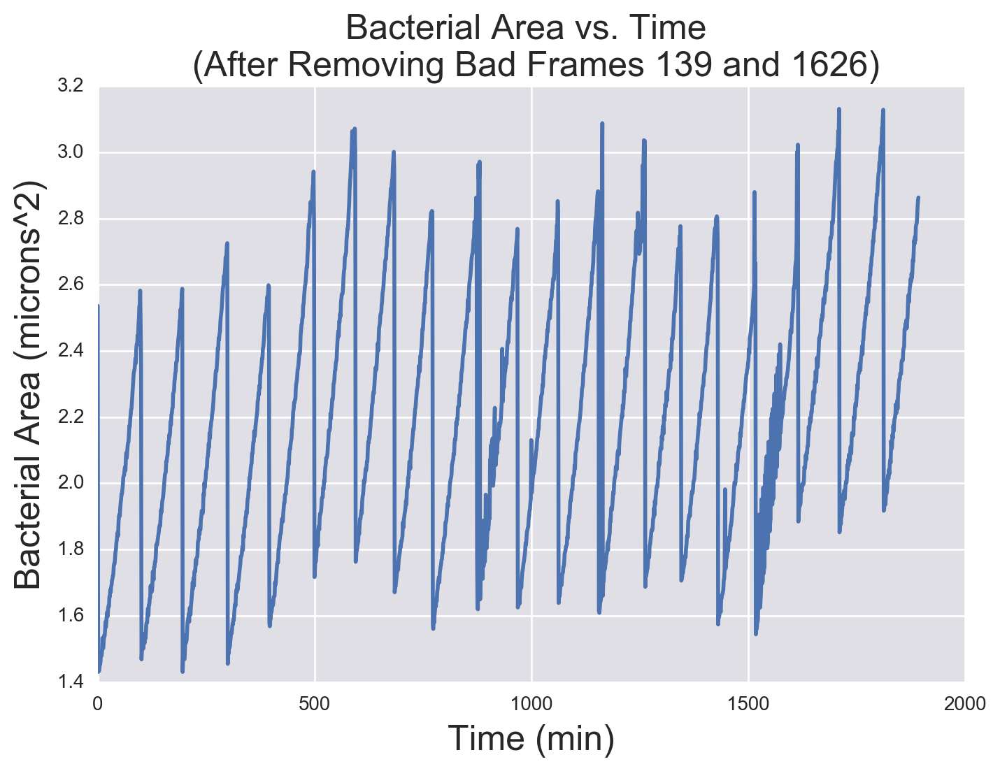

In [450]:
plt.plot(t_bac_1_3, bac_1_intensities_fixed_3)

plt.title('Bacterial Area vs. Time \n (After Removing Bad Frames 139 and 1626)')
plt.ylabel('Bacterial Area (microns^2)')
plt.xlabel('Time (min)')

Again, this data is still noisy, but we can deal with that when we look at the growth cycles. 

## Finding Division Times for Bacterium 1

We want to compute the timescale of division bacterium 1. Before we do so, I would like to store the data we have collected so far in a dataframe. 

In [452]:
data_bac_1_final={'Time': t_bac_1_3, 
     'Bac_area': bac_1_intensities_fixed_3, 
     'Bac_num': 1}

df_bac_1_final = pd.DataFrame(data_bac_1_final)
df_bac_1_final.head()

,Bac_area,Bac_num,Time
0,2.536352,1,0.0
1,1.430416,1,1.0
2,1.441232,1,2.0
3,1.433120,1,3.0
4,1.441232,1,4.0


We want to figure out where the growth cycles end. These correspond to drops in the area. We can use np.diff() + a threshold in the drop of area expected to weed out random oscillations to isolate the growth cycles. 

In [453]:
diff_bac_areas_final = np.zeros(len(df_bac_1_final))
diff_bac_areas_final[1::] = np.diff(df_bac_1_final['Bac_area'].values)

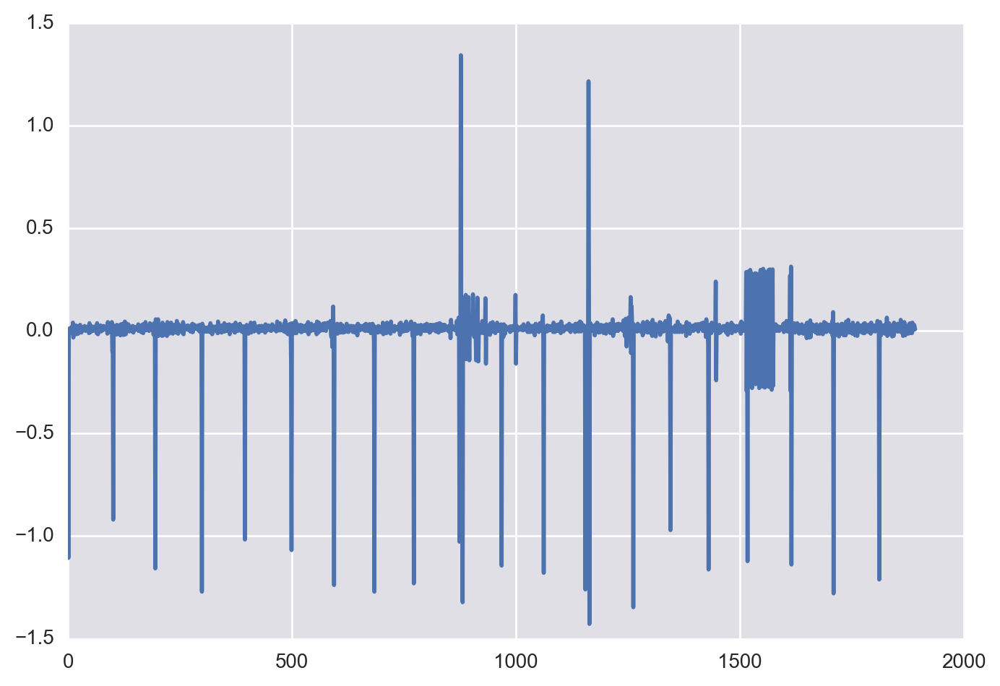

In [454]:
plt.plot(diff_bac_areas_final)

In [455]:
# Add a column of the dA/dt calculated with np.diff into the dataframe
df_bac_1_final['diff'] = pd.Series(diff_bac_areas_final, index=df_bac_1_final.index)

# Figuring out where the drops are
inds = df_bac_1_final['diff'] < -0.5
df_bac_1_final['drop'] = pd.Series(inds, index=df_bac_1_final.index)

# Since we have True marking wherever a new growth cycle starts, we can just take the cumulative sum
df_bac_1_final['growth_cycle_number'] = df_bac_1_final['drop'].cumsum()
df_bac_1_final.head()

,Bac_area,Bac_num,Time,diff,drop,growth_cycle_number
0,2.536352,1,0.0,0.000000,False,0
1,1.430416,1,1.0,-1.105936,True,1
2,1.441232,1,2.0,0.010816,False,1
3,1.433120,1,3.0,-0.008112,False,1
4,1.441232,1,4.0,0.008112,False,1


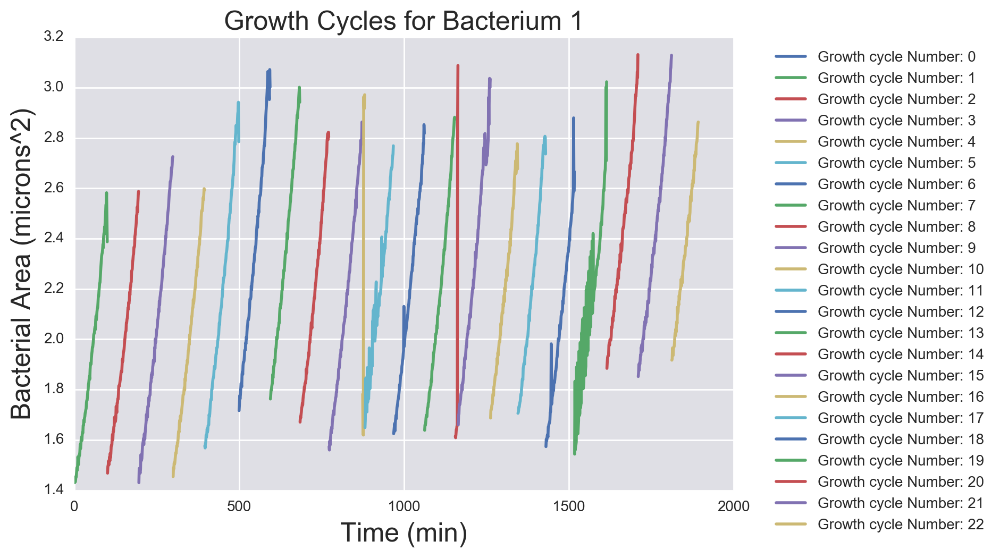

In [457]:
for i in df_bac_1_final['growth_cycle_number'].unique():
    inds = df_bac_1_final['growth_cycle_number'] == i
    df_num = df_bac_1_final.loc[inds]
    plt.plot(df_num['Time'], df_num['Bac_area'], label = 'Growth cycle Number: {}'.format(i))
    plt.legend(bbox_to_anchor=(1.4, 1.0))
    plt.title('Growth Cycles for Bacterium 1')
    plt.ylabel('Bacterial Area (microns^2)')
    plt.xlabel('Time (min)')

We still have pretty noisy data. However, we also have several beautiful growth curves that we can analyze. For the purposes of saving time, I'm going to remove the noisy growth curves and the random spikes that clearly aren't growth curves from our analysis. 

However, it is important to note that we do lose some information here. If I had more time, I would go through and analyze why some of the curves are so noisy. Perhaps there's a random piece of junk that keeps floating in and out of the frame. Perhaps I can improve the image segmentation. 

However, now in the interests of time, I will remove these noisy curves as follows.

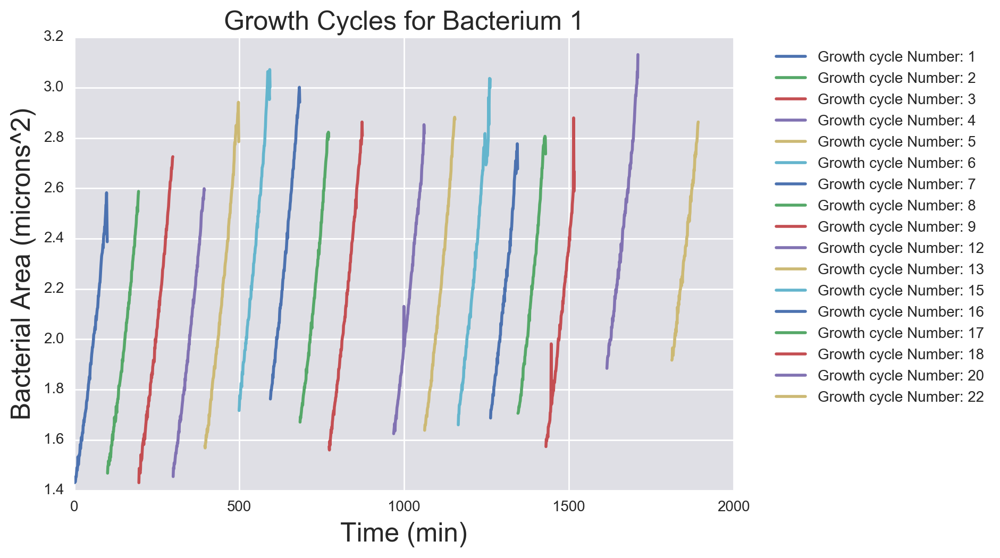

In [458]:
inds_to_remove = (df_bac_1_final['growth_cycle_number'] == 0) | (df_bac_1_final['growth_cycle_number'] == 19) | \
(df_bac_1_final['growth_cycle_number'] ==10) | \
(df_bac_1_final['growth_cycle_number'] ==11) | \
(df_bac_1_final['growth_cycle_number'] ==14) | \
(df_bac_1_final['growth_cycle_number'] ==21)

df_bac_1_final_less_noisy = df_bac_1_final.loc[~inds_to_remove, :]

for i in df_bac_1_final_less_noisy['growth_cycle_number'].unique():
    inds = df_bac_1_final_less_noisy['growth_cycle_number'] == i
    df_num_2 = df_bac_1_final_less_noisy.loc[inds]
    plt.plot(df_num_2['Time'], df_num_2['Bac_area'], label = 'Growth cycle Number: {}'.format(i))
    plt.legend(bbox_to_anchor=(1.4, 1.0))
    plt.title('Growth Cycles for Bacterium 1')
    plt.ylabel('Bacterial Area (microns^2)')
    plt.xlabel('Time (min)')

These are fairly clean growth curves that we can use for our Bayesian analysis. 

Now, we can find the division time for Bacterium 1. 

In [358]:
print('Time between division for Bacteria 1:\n')
all_times = []
for i in df_bac_1_final_less_noisy['growth_cycle_number'].unique():
    inds_temp = df_bac_1_final_less_noisy['growth_cycle_number'] == i
    df_temp = df_bac_1_final_less_noisy.loc[inds_temp]
    time_between_divisions = df_temp['Time'].values[-1] - df_temp['Time'].values[0]
    all_times.append(time_between_divisions)
    print('''Growth cycle {}: {} min'''.format(i, time_between_divisions))
print('''\nAverage division time for Bacteria 1: {} min'''.format(sum(all_times)/len(all_times)))

Time between division for Bacteria 1:

Growth cycle 1: 99.0 min
Growth cycle 2: 94.0 min
Growth cycle 3: 103.0 min
Growth cycle 4: 95.0 min
Growth cycle 5: 103.0 min
Growth cycle 6: 94.0 min
Growth cycle 7: 89.0 min
Growth cycle 8: 87.0 min
Growth cycle 9: 101.0 min
Growth cycle 12: 93.0 min
Growth cycle 13: 92.0 min
Growth cycle 15: 97.0 min
Growth cycle 16: 82.0 min
Growth cycle 17: 84.0 min
Growth cycle 18: 86.0 min
Growth cycle 20: 94.0 min
Growth cycle 22: 80.0 min

Average division time for Bacteria 1: 92.52941176470588 min


We have a range of division times, anywhere from 80 minutes to 103 minutes. This is odd because it's the same bacterium  dividing under practically the same conditions over time, so I would have expected to see more consistent results.

We can go through and quickly analyze bacterium 2 as well as follows. We follow the same troubleshooting pipeline from before

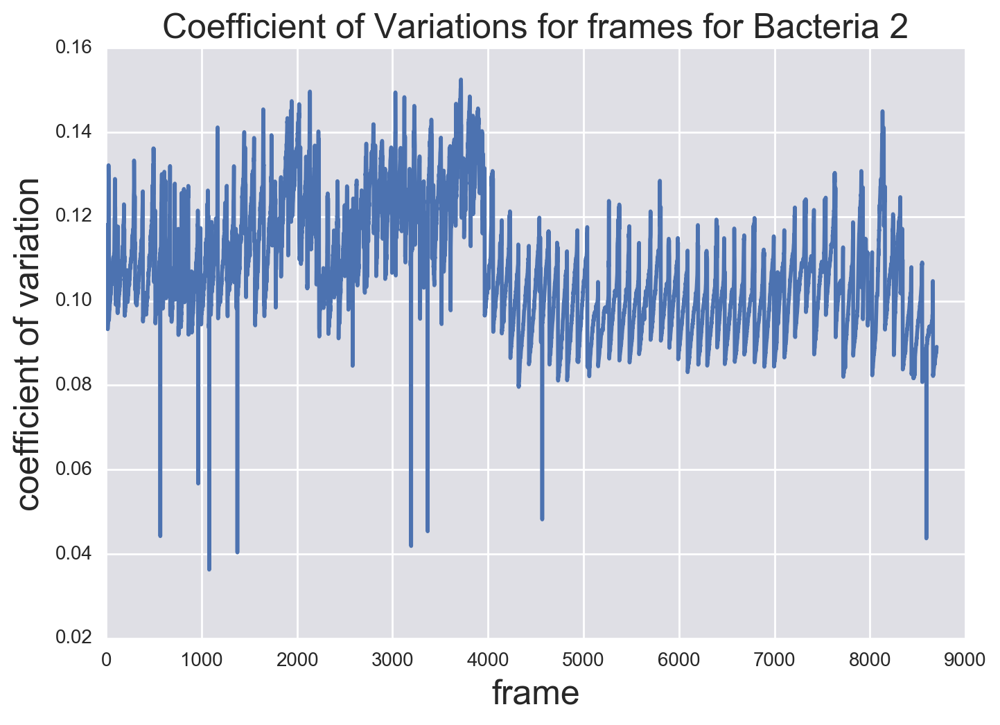

In [459]:
covs_bac_2 = np.array([im.std() / im.mean() for im in ic_bac_2])
plt.plot(covs_bac_2)
plt.xlabel('frame')
plt.ylabel('coefficient of variation');
plt.title("Coefficient of Variations for frames for Bacteria 2")
plt.figure()

In [460]:
good_frames_bac_2 = [i for i in range(len(ic_bac_2)) if covs_bac_2[i] > 0.07]
bad_frames_bac_2 = [i for i in range(len(ic_bac_2)) if covs_bac_2[i] < 0.07]
ic_bac_2_fixed = [ic_bac_2[i] for i in good_frames_bac_2]
ic_bac_2_bad = [ic_bac_2[i] for i in bad_frames_bac_2]


In [ ]:
bac_2_after_blurry_frames = find_bacterial_area(ic_bac_2_fixed, 2)

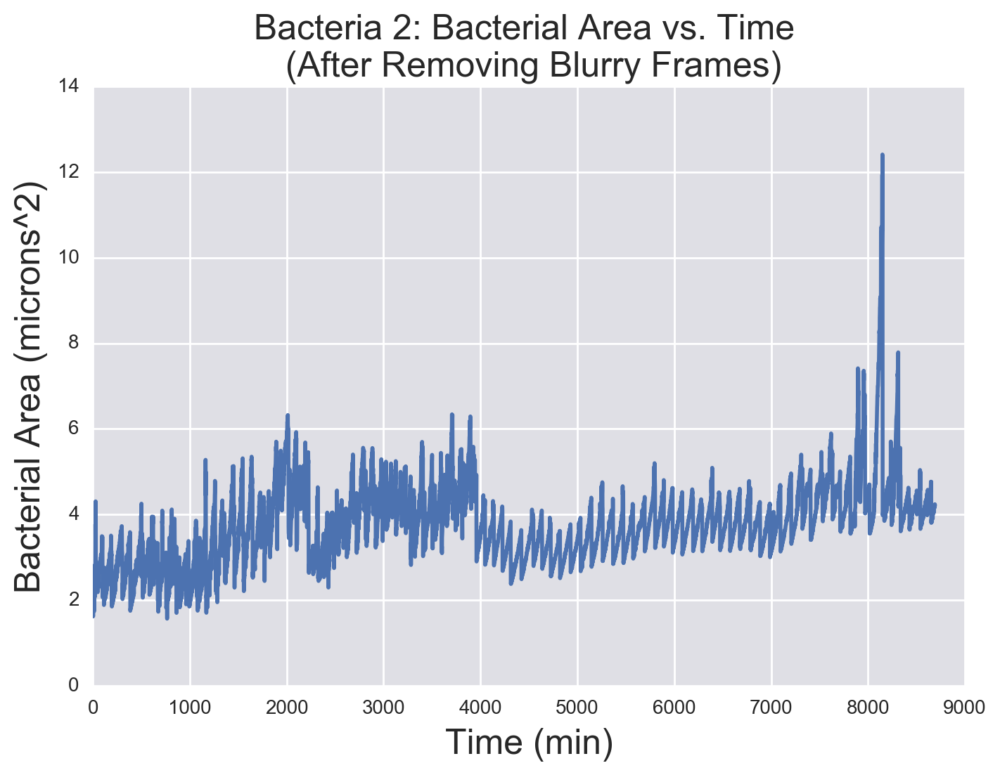

In [462]:
t_bac_2 = (np.array(good_frames_bac_2, dtype=np.float) - good_frames_bac_2[0]) * dt
plt.plot(bac_2_after_blurry_frames)

plt.title('Bacteria 2: Bacterial Area vs. Time \n (After Removing Blurry Frames)')
plt.ylabel('Bacterial Area (microns^2)')
plt.xlabel('Time (min)')

Well, watching through the movie, we see that we have a whole slew of problems to deal with this. There are random bacteria that float in and out. There's random junk that shows up. We will have to watch the movie and find all the bad frames. Since it will take too much time to fix, we can refine our segmenting technique. This time, we will only keep the largest labeled region in the frame, which is probably the bacteria. 

In [476]:
def find_bacterial_area_2(ic, bac_num):
    bacterial_areas = []
    for i in range(len(ic)):
        im = ic[i]
        im_filt, k = bebi103_thresh_my_version(im, selem_2, bac_num, white_true=False, min_size=100)
        
        # Label binary image; backward kwarg says value in im_bw to consider backgr.
        im_labeled, n_labels = skimage.measure.label(
                            im_filt, background=0, return_num=True)
        im_props = skimage.measure.regionprops(im_labeled)
        
        max_so_far = 0
        
        for prop in im_props:
            if prop.area > max_so_far:
                max_so_far = prop.area

        bacterial_area_pix = max_so_far

        # Define interpixel distance
        interpix_dist = 0.052  # microns

        # Compute bacterial area in square microns and add to the list of bacterial_areas. 
        bacterial_area_micron = bacterial_area_pix * interpix_dist**2
        bacterial_areas.append(bacterial_area_micron)

    return np.array(bacterial_areas)


In [477]:
bac_2_alt = find_bacterial_area_2(ic_bac_2_fixed, 2)

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 12 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)
C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\skimage\filters\rank\generic.py:68: UserWarning: Bitdepth of 13 may result in bad rank filter performance due to large number of bins.
  "performance due to large number of bins." % bitdepth)


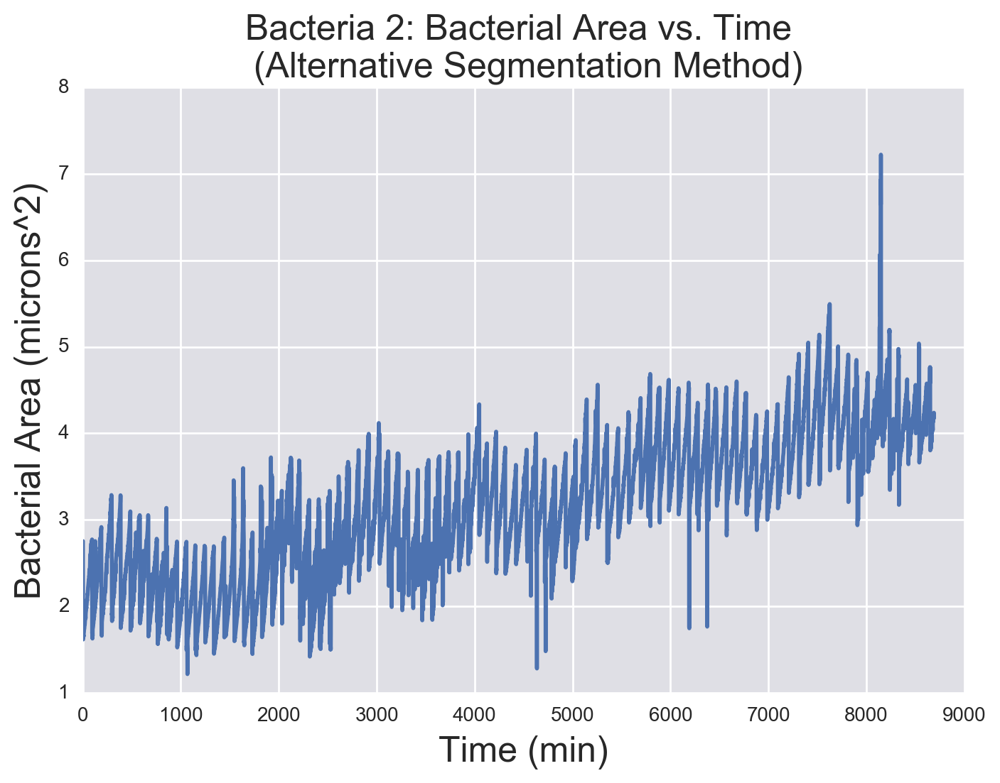

In [485]:
plt.plot(bac_2_alt)

plt.title('Bacteria 2: Bacterial Area vs. Time \n (Alternative Segmentation Method)')
plt.ylabel('Bacterial Area (microns^2)')
plt.xlabel('Time (min)')

In [479]:
data_bac_2 ={'Time': t_bac_2, 
     'Bac_area': bac_2_alt, 
     'Bac_num': 2}

df_bac_2 = pd.DataFrame(data_bac_2)
df_bac_2.head()

,Bac_area,Bac_num,Time
0,2.752672,2,0.0
1,1.616992,2,1.0
2,1.614288,2,2.0
3,1.625104,2,3.0
4,1.641328,2,4.0


In [480]:
diff_bac_areas_2 = np.zeros(len(df_bac_2))
diff_bac_areas_2[1::] = np.diff(df_bac_2['Bac_area'].values)

(-2, 2)

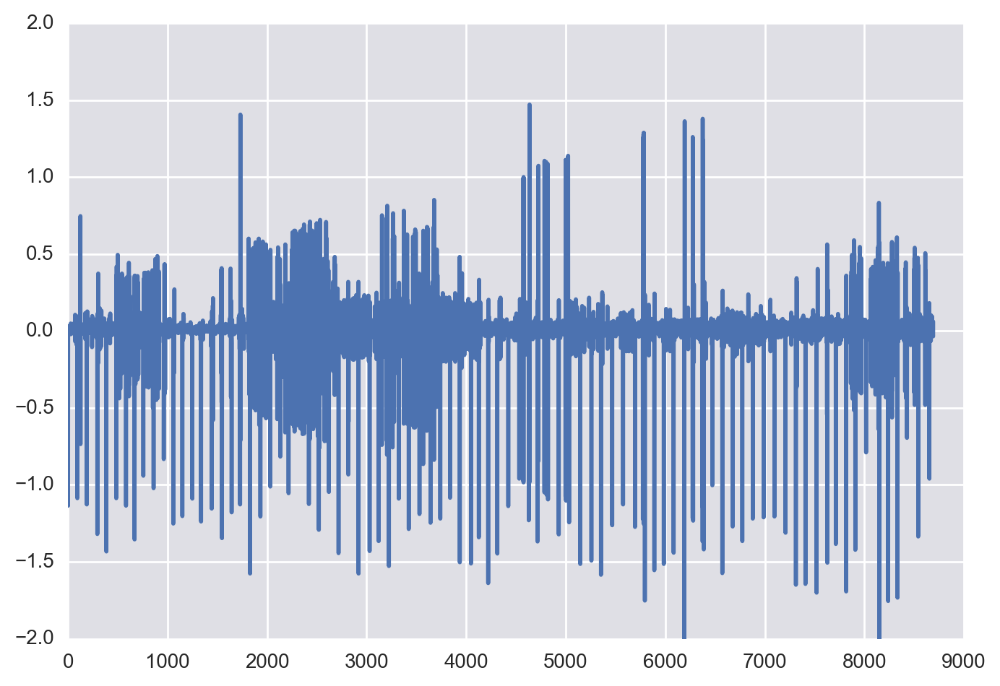

In [481]:
plt.plot(diff_bac_areas_2)
plt.ylim([-2, 2])

In [486]:
# Add a column of the dA/dt calculated with np.diff into the dataframe
df_bac_2['diff'] = pd.Series(diff_bac_areas_2, index=df_bac_2.index)

# Figuring out where the drops are
inds = df_bac_2['diff'] < -0.70
df_bac_2['drop'] = pd.Series(inds, index=df_bac_2.index)

# Since we have True marking wherever a new growth cycle starts, we can just take the cumulative sum
df_bac_2['growth_cycle_number'] = df_bac_2['drop'].cumsum()
df_bac_2.head()

,Bac_area,Bac_num,Time,diff,drop,growth_cycle_number
0,2.752672,2,0.0,0.000000,False,0
1,1.616992,2,1.0,-1.135680,True,1
2,1.614288,2,2.0,-0.002704,False,1
3,1.625104,2,3.0,0.010816,False,1
4,1.641328,2,4.0,0.016224,False,1


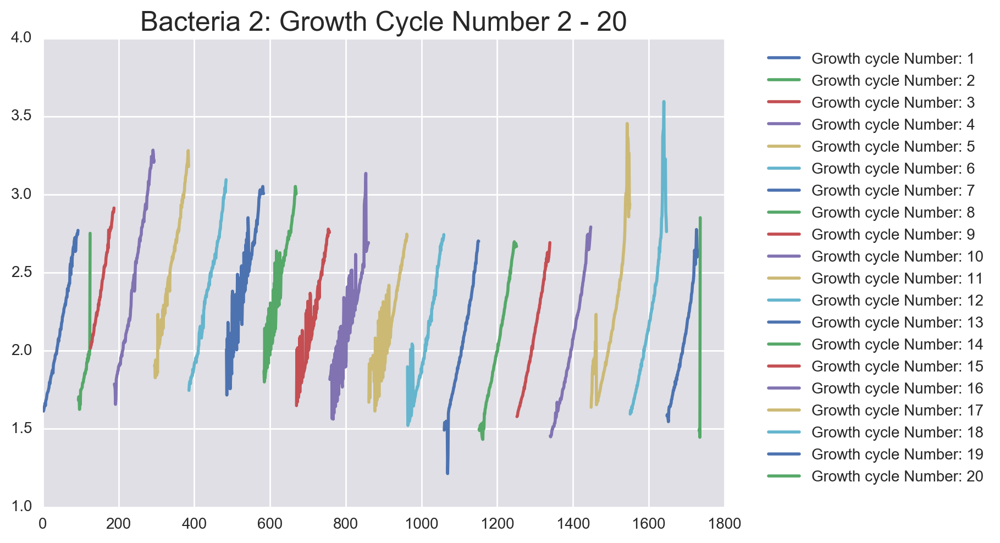

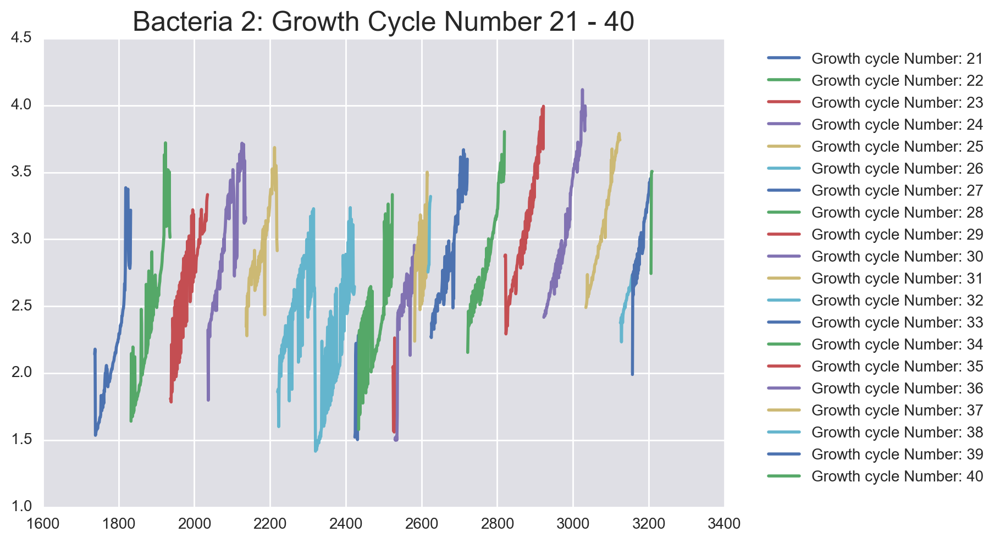

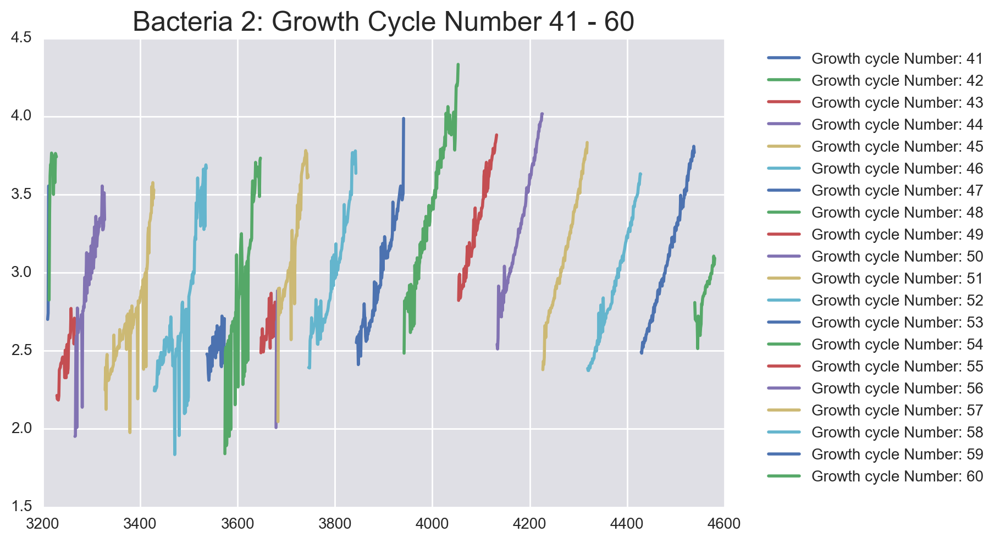

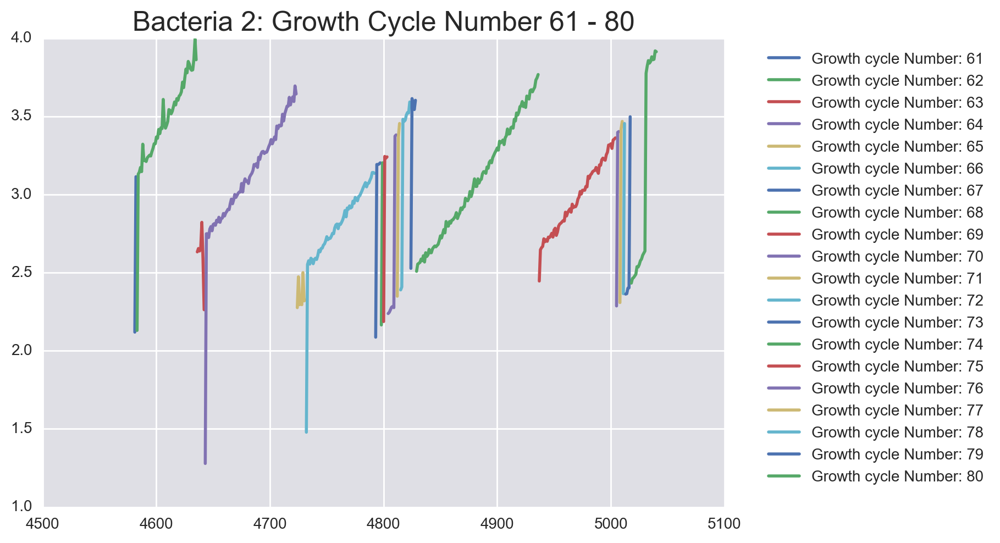

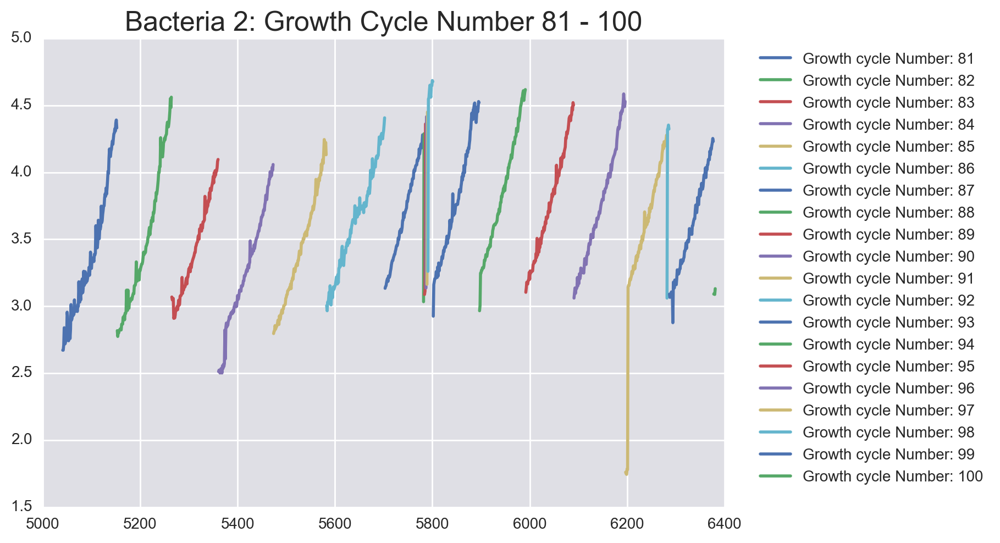

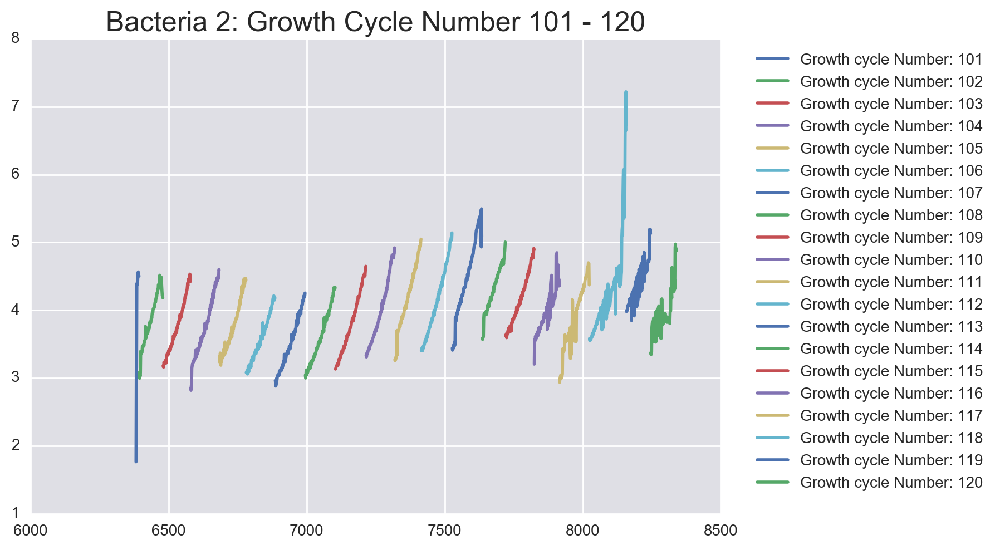

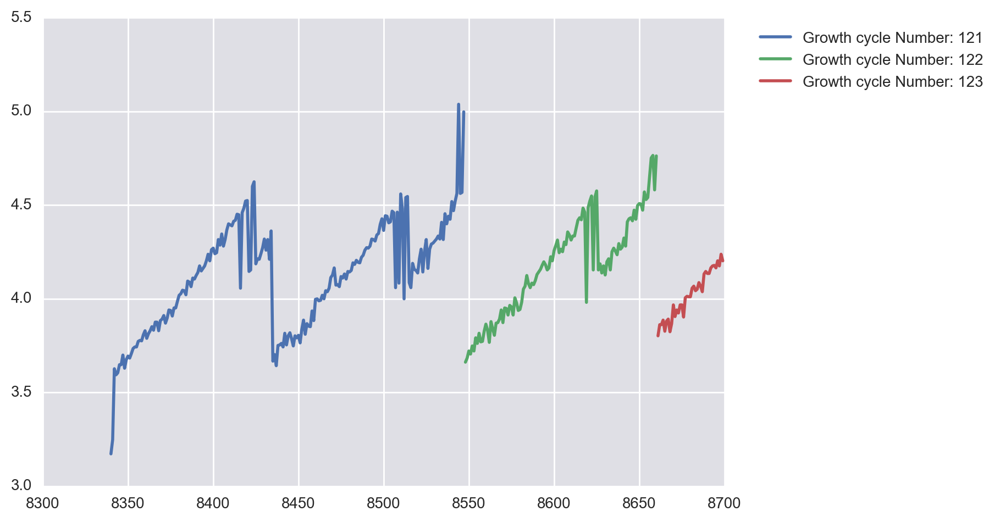

In [488]:
last_i = 1
for i in df_bac_2['growth_cycle_number'].unique():
    if i!= 0:
        inds_bac_2 = df_bac_2['growth_cycle_number'] == i
        df_tempp = df_bac_2.loc[inds_bac_2]
        plt.plot(df_tempp['Time'], df_tempp['Bac_area'], label = 'Growth cycle Number: {}'.format(i))

        plt.legend(bbox_to_anchor=(1.4, 1.0))
        if (i % 20)==0:
            
            plt.title('Bacteria 2: Growth Cycle Number {} - {}'.format(last_i+1, i))
            plt.figure()
            last_i = i
            

These are some awful growth curves. We need to go back improve our segmentation technique. However, I'm running out of time and that PTMCMC isn't going to run itself, so I'm going to keep the data as it is. I'm going to go through and remove the random drops in intensity that are too short to be growth curves

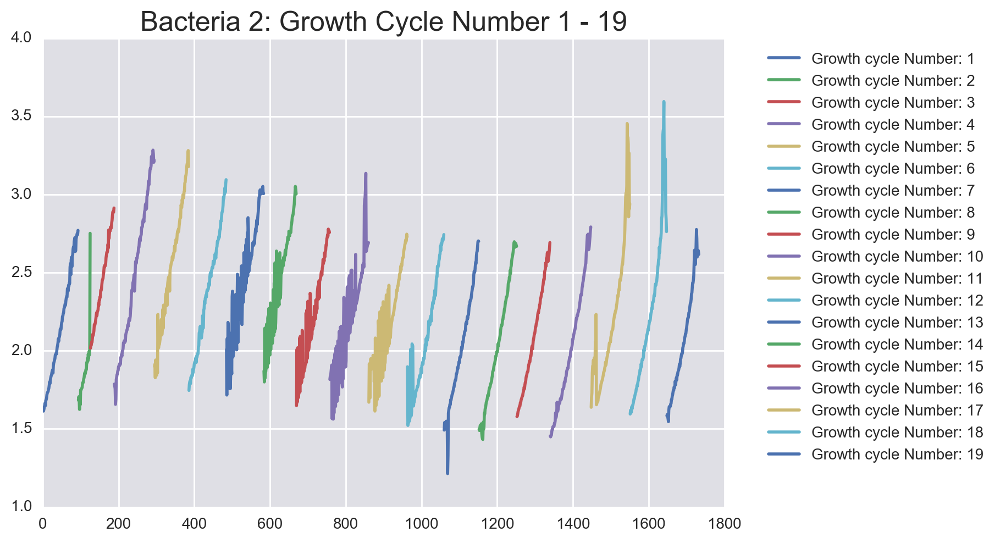

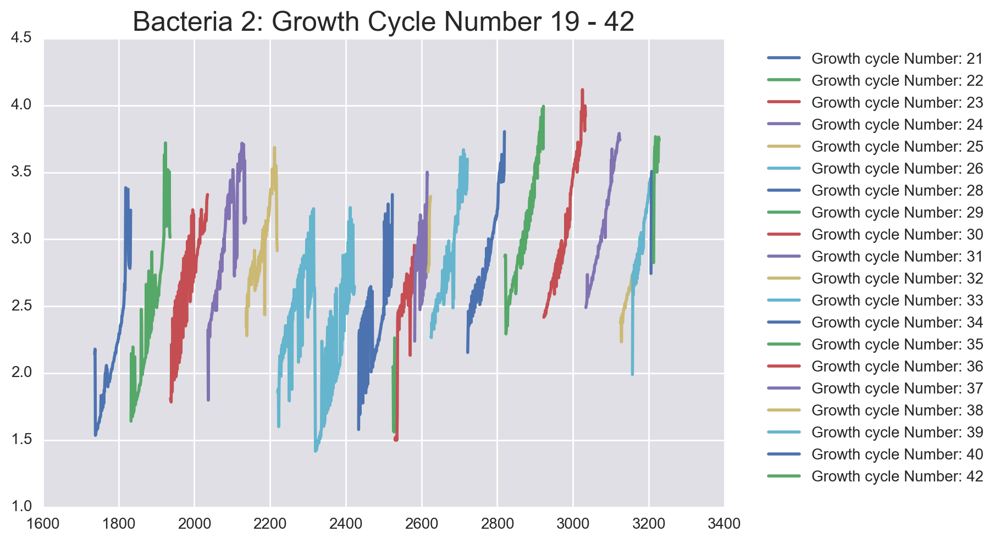

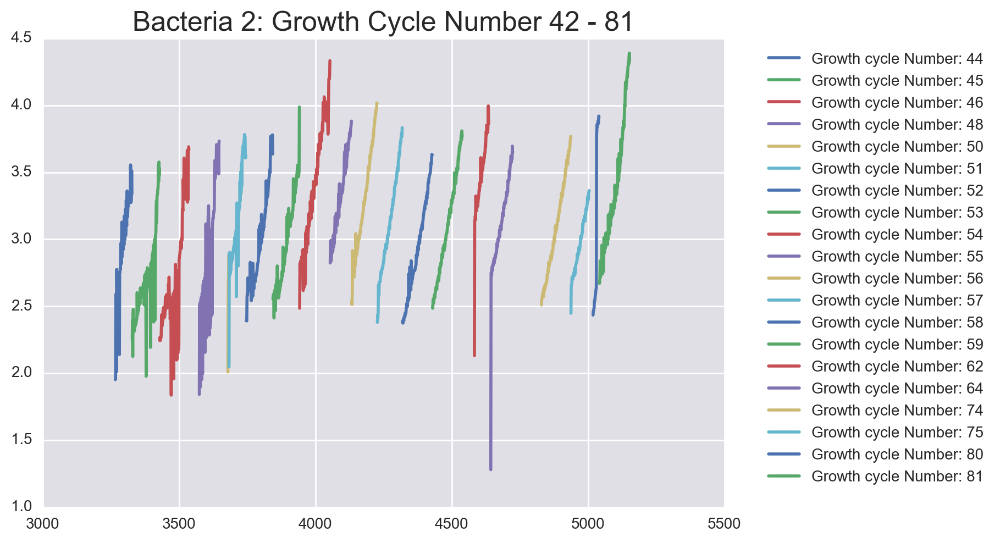

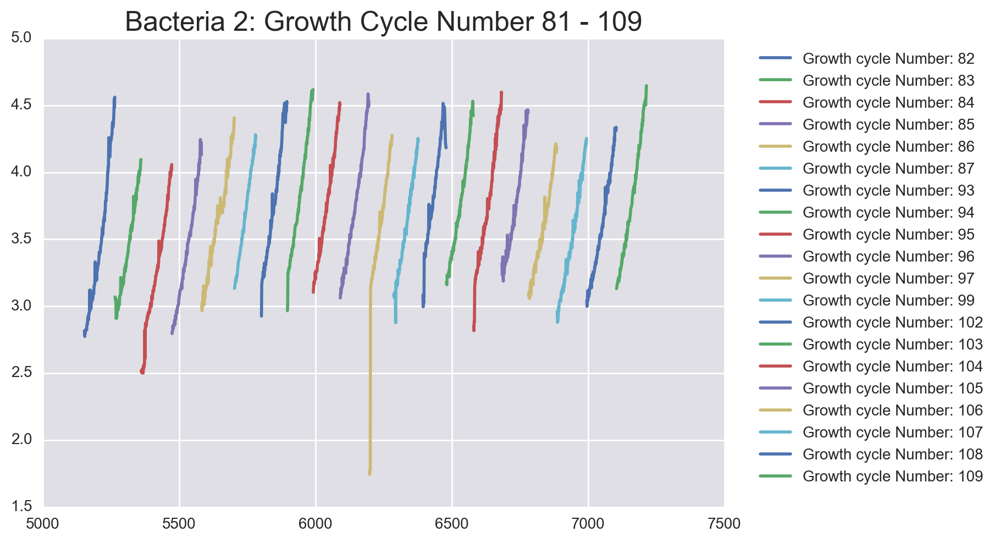

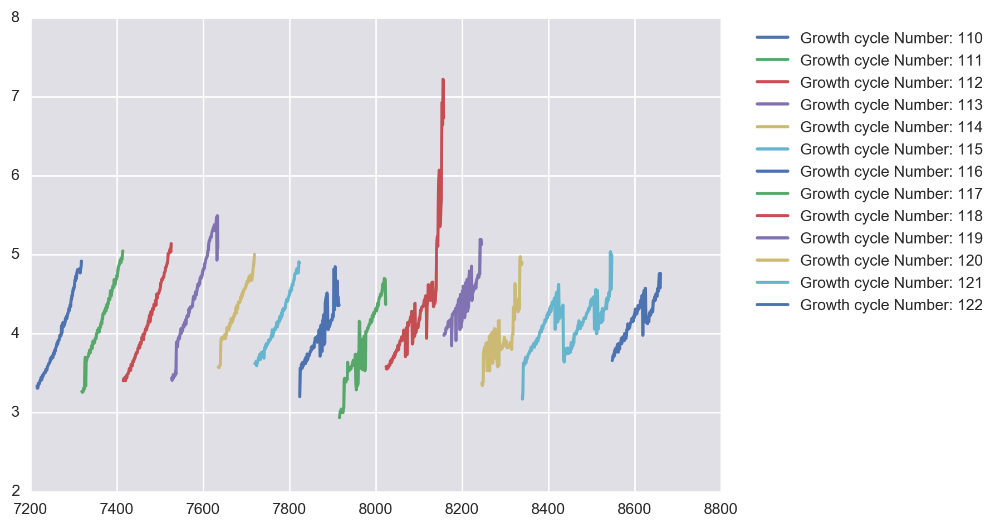

In [512]:
inds_to_remove_bac_2 = (df_bac_2['growth_cycle_number'] == 20) | (df_bac_2['growth_cycle_number'] == 27) | \
    (df_bac_2['growth_cycle_number'] ==41) | \
    (df_bac_2['growth_cycle_number'] ==43) | \
    (df_bac_2['growth_cycle_number'] ==47) | \
    (df_bac_2['growth_cycle_number'] ==49) | \
    (df_bac_2['growth_cycle_number'] ==60) | \
    (df_bac_2['growth_cycle_number'] ==61) | \
    (df_bac_2['growth_cycle_number'] ==63) | \
    (df_bac_2['growth_cycle_number'] ==65) | \
    (df_bac_2['growth_cycle_number'] ==66) | \
    (df_bac_2['growth_cycle_number'] ==67) | \
    (df_bac_2['growth_cycle_number'] ==68) | \
    (df_bac_2['growth_cycle_number'] ==69) | \
    (df_bac_2['growth_cycle_number'] ==70) | \
    (df_bac_2['growth_cycle_number'] ==71) | \
    (df_bac_2['growth_cycle_number'] ==72) | \
    (df_bac_2['growth_cycle_number'] ==73) | \
    (df_bac_2['growth_cycle_number'] ==76) | \
    (df_bac_2['growth_cycle_number'] ==77) | \
    (df_bac_2['growth_cycle_number'] ==78) | \
    (df_bac_2['growth_cycle_number'] ==79) | \
    (df_bac_2['growth_cycle_number'] ==88) | \
    (df_bac_2['growth_cycle_number'] ==89) | \
    (df_bac_2['growth_cycle_number'] ==90) | \
    (df_bac_2['growth_cycle_number'] ==91) | \
    (df_bac_2['growth_cycle_number'] ==92) | \
    (df_bac_2['growth_cycle_number'] ==98) | \
    (df_bac_2['growth_cycle_number'] ==100) | \
    (df_bac_2['growth_cycle_number'] ==101) | \
    (df_bac_2['growth_cycle_number'] ==123) 

df_bac_2_less_noisy = df_bac_2.loc[~inds_to_remove_bac_2, :]

last_count = 1
count = 0
for i in df_bac_2_less_noisy['growth_cycle_number'].unique():
    count+= 1
    if i!= 0:
        inds_bac_2_2 = df_bac_2_less_noisy['growth_cycle_number'] == i
        df_tempp_2 = df_bac_2_less_noisy.loc[inds_bac_2_2]
        plt.plot(df_tempp_2['Time'], df_tempp_2['Bac_area'], label = 'Growth cycle Number: {}'.format(i))
        plt.legend(bbox_to_anchor=(1.4, 1.0))
        if (count % 20)==0:

            plt.title('Bacteria 2: Growth Cycle Number {} - {}'.format(last_count, i))
            plt.figure()
            last_count = i



Again, the purposes of the above code is to remove short spikes, which are too short to be true growth curves. They're probably random things that come in and out of the frame. Ideally, I should go back and improve my segmentation to deal with this, but I don't have time for that. Unfortunately, removing these growth cycles means that we could be losing important information. 

My remaining curves are still pretty noisy, but I'm going to fit the data asit. 



For the purposes of having data that I can use for analysis, I'm going to keep growth curves 120-140 because it seems like these were segmented well, even with my current segmentation technique. While I have lost a significant amount of data, 20 growth cycles is still a good amount of data. However, again I am losing valuable information. If I had more time, I would go back and improve my image segmentation technique to 


We need to calculate the time between division for each growth cycle. 


Time between division for Bacteria 2:

Average division time for Bacteria 2: 88.55913978494624 min
Standard deviation of division time for Bacteria 2: 33.57465197398193 min


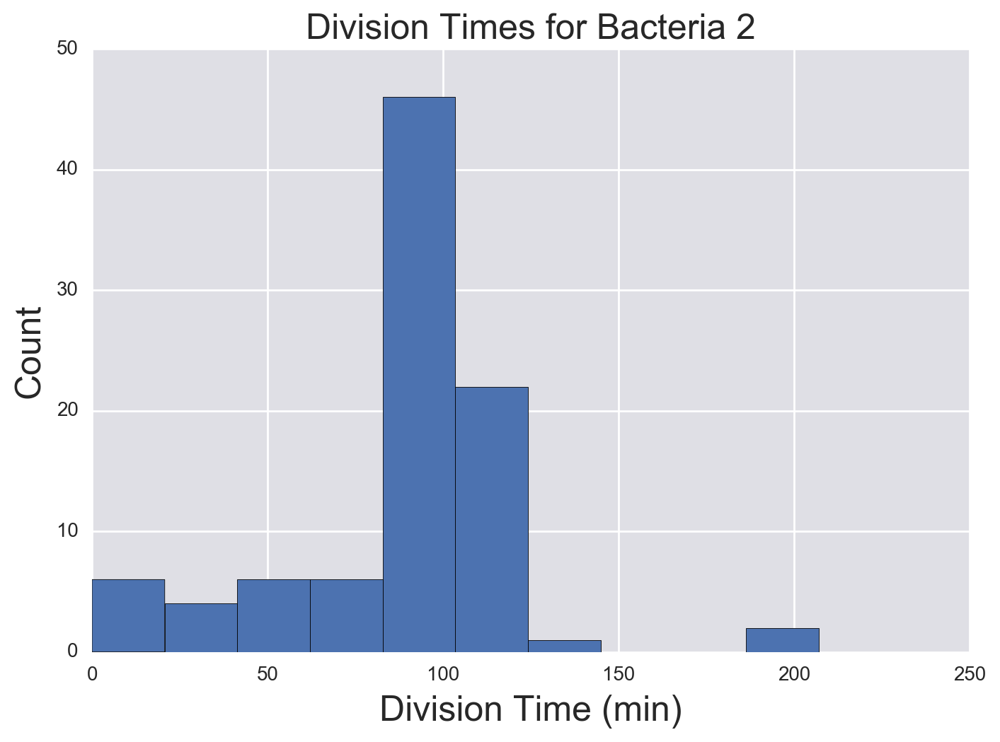

In [510]:
print('Time between division for Bacteria 2:\n')
all_times_b2 = []
for i in df_bac_2_less_noisy['growth_cycle_number'].unique():
    inds_sigh = df_bac_2_less_noisy['growth_cycle_number'] == i
    df_sigh = df_bac_2_less_noisy.loc[inds_sigh]
    time_between_divisions_b2 = df_sigh['Time'].values[-1] - df_sigh['Time'].values[0]
    all_times_b2.append(time_between_divisions_b2)
all_times_b2 = np.array(all_times_b2)


plt.hist(all_times_b2)
plt.xlabel('Division Time (min)')
plt.ylabel('Count')
plt.title('Division Times for Bacteria 2')
print('''Average division time for Bacteria 2: {} min'''.format(np.mean(all_times_b2)))
print('''Standard deviation of division time for Bacteria 2: {} min'''.format(np.std(all_times_b2)))


So, just like with bacteria 1, it appears the division time is around 90 minutes. However, also just like with Bacteria 1, there seems to be a large amount of variation. There appear to be a few outliers where it seems like it took the bacteria nearly 200 minutes to divide. We should investigate why this occurred. Perhaps it's an error in segmentation.

**(c) We know that under ideal conditions, bacterial cells experience exponential growth in bulk. That is, the number of cells grows exponentially. This is possible regardless of how individual cells growth; the repeated divisions leads to exponential growth. In their paper, the authors argue that the growth rate of each cell is also exponential.**

$$a(t) = a_0 e^{kt}$$

**where  $a(t)$  is the area of the cell in the image as a function of time and  $a_0$  is the area of the cell right after a division has been completed, which we mark as $t=0. $ As an alternative model, the authors consider a linear growth model, 

$$a(t) = a_0 + bt$$

**in which an exponential curve is approximately linear for short time scales. So, it is often difficult to distinguish between a linear and an exponential growth rate. Use the model selection methods we learned in class to assess the relative probabilities that the growth rate is exponential versus linear. You may consider using a hierarchical model**

## Comparing the two models

We need to decide if we want to consider the models (i.e. exponential vs linear growth models) as hierarchical models. While biologically speaking, they probably are (namely, the parameters we get from these growth divisions $a_0$, $k$, and $b$ are governed by a larger  hyperparameters'), we decided that the hierarchical model was going to be too computationally intensive to be feasible. 

Instead, we decided to consider each growth cycle as its own independent dataset. In reality, this assumption isn't true: each division isn't independent, especially since its the same bacteria dividing over time. Things that happen in earlier divisions (i.e. mutations) will definitely affect later divisions. 

However, after much deliberation, we thought this would be the best alternative. Since we were constantly flowing in new media,  each division technically happened under identical conditions. Thus, assuming that each growth cycle is independent has some basis. We also thought pooling all the data, and just fitting the data wouldn't make sense because as we saw already in part (b), there was a lot of variation in the division times. And again, while it is the most accurate model, we thought the hierarchical model would be too computationally intensive.


<div class="alert alert-info">Good job specifying! But I'm curious why "each division technically happened under identical conditions" still encourages you to consider these as independent events. Rather, I might say that it's close to impossible to keep the experimental conditions perfectly identical for each division (the temperature of the lab is changing, maybe the cell is secreting something), so if I'm not going to treat them as somewhat related, I would treat them as independent. A broad distribution of division times could be modeled with a statistical model with a broad distribution.</div>

### Model 1: Growth rate of each cell is exponential

Model: $a(t) = a_0 e^{kt}$

**Defining Priors**

$a_0$ and $k$ are both scale parameters that we know nothing about. So, we use a Jeffrey's prior for both. 

**Defining the Likelihood**

Next, because this is a process that involves many different variables, we can assume a Gaussian likelihood for the data

\begin{align}
P(D \mid a_0,k, I) = \prod_i \frac{1}{\sqrt{2\pi \sigma^2}}\,
\exp\left\{-\frac{(a_i - a(t,a_0,k ))^2}{2\sigma^2}\right\}.
\end{align}


$$P(D \mid a_0,k, I) = \Big(\frac{1}{2\pi \sigma^2}\Big)^{-\frac{n}{2}} \exp \Big \{ {\frac{1}{2\sigma^2}\sum\limits_{i=1}^{n} (a_i - a(t,a_0,k ))^2} \Big \}$$

where $a$ is given by  $a(t) = a_0 e^{kt}$



<div class="alert alert-info">Be careful about explaining your likelihood model- yes, Gaussian is what we tend to use when we're fitting data that has a dependence on multiple parameters, but that's not the full explanation. Instead, we have data and a model prediction (i.e. the measurement has some complicated dependence on a set of parameters), and we expect the difference between those things (either because of biological noise or experimental variability) to be Gaussian distributed. We could equally expect it to be Cauchy-distributed, if we thought there would be larger differences (i.e. if we expected there to be things that looked like outliers). So fitting multiple parameters need not require a Gaussian likelihood. </div>

### Model 2: Growth rate of each cell is linear

Model: $a(t) = a_0 + bt$

**Defining Priors**

$a_0$ is a positional parameter, while $b$ is a scale parameter. So, we will use a uniform prior for $a_0$ and Jeffrey's prior for $b$

**Defining the Likelihood**

Next, because this is a process that involves many different variables, we can assume a Gaussian likelihood for the data

\begin{align}
P(D \mid a_0,b, I) = \prod_i \frac{1}{\sqrt{2\pi \sigma^2}}\,
\exp\left\{-\frac{(a_i - a(t,a_0,b ))^2}{2\sigma^2}\right\}.
\end{align}


$$P(D \mid a_0,b, I) = \Big(\frac{1}{2\pi \sigma^2}\Big)^{-\frac{n}{2}} \exp \Big \{ {\frac{1}{2\sigma^2}\sum\limits_{i=1}^{n} (a_i - a(t,a_0,b ))^2} \Big \}$$

where $a$ is given by  $a(t) = a_0 + bt$

We can code this as follows:

In [315]:
# Theoretical models
def exponential_growth_model(t, a_0, k):
    """
    Theoretical model for exponential growth model
    """
    a = a_0 * np.exp(k*t)
    
    return a

def linear_growth_model(t, a_0, b):
    """
    Theoretical model for the linear growth model
    """
    a = a_0 + b*t
    
    return a

# Likelihood
def log_likelihood_gaussian(p, x, exponential=False):
    """
    Gaussian log likelihood.
    """
    # Exponential model
    if exponential:
        a_0, k, sigma = p
        t, a = x
        theoretical_a = exponential_growth_model(t, a_0, k) 

    # Linear model
    else:
        a_0, b, sigma = p
        t, a = x
        theoretical_a = linear_growth_model(t, a_0, b) 
        
    resid = a - theoretical_a
    return -np.sum(resid**2) / 2 / sigma**2 \
                - len(a) / 2 * np.log(2 * np.pi * sigma**2)
        
# Prior
def log_prior(p, p_range, exponential=False):
    """
    Log of the prior with p = np.array([a_0, k, sigma]).
    
    p_range = np.array([[a_0_min, a_0_max], 
                        [k_min,   k_max],
                        [sigma_min,   sigma_max]])  
                        
    """
    if (p < p_range[:,0]).any() or (p > p_range[:,1]).any():
        return -np.inf
    if exponential:
        return - np.log(np.log(p_range[1,1] / p_range[1,0]) * p[1])- np.log(np.log(p_range[0,1] / p_range[0,0]) * p[0])\
             - np.log(np.log(p_range[2,1] / p_range[2,0]) * p[2])

    else: #use a uniform prior for a
        return - np.log(np.log(p_range[0,1] / p_range[0,0]) * p[0])- np.log(p_range[1,1] - p_range[1,0]) \
             - np.log(np.log(p_range[2,1] / p_range[2,0]) * p[2])
    
# Posterior 
def log_posterior(p, x, p_range, exponential=False):
    """
    Log posterior for either exponential or linear model
    """
    lp = log_prior(p, p_range)
    if lp == -np.inf:
        return -np.inf

    return log_likelihood_gaussian(p, x, exponential=exponential) + lp

    
def neg_log_posterior(p, x, p_range, exponential=False):
    return -log_posterior(p, x, p_range, exponential=exponential)


In [525]:
def fit_model(df, growth_cycle, p_range, sigma_init, exponential=False, print_results=False):
    """
    Perform regression on each growth cycle.
    """
    # Extract data
    inds = df['growth_cycle_number'] == growth_cycle
    t = df.loc[inds, 'Time'].values 
    t_adjusted = t - t[0]
    a = df.loc[inds, 'Bac_area'].values
    x = (t_adjusted, a)

    # Arguments to pass to log posterior
    args = (x, p_range, exponential)
    
    # Initial guess
    # Best guesses determined from the data except for sigma_init, which we guess
    a_init = a.min()
    k_init = np.log(a.max()/a.min())/(t_adjusted[-1]-t_adjusted[0])
    sigma_init = sigma_init
    p0 = np.array([a_init, k_init, sigma_init])
        
    # Get optimal parameters for each
    popt_model = scipy.optimize.minimize(neg_log_posterior,  p0, args=args).x
    
    # Compute posterior covariance matrices for each
    cov_model = np.linalg.inv(bebi103.approx_hess(popt_model, neg_log_posterior, args=args))
    # Compute errors
    a_err, k_err, sigma_err = np.sqrt(np.diag(cov_model))
    
    #odds = popt_model[0]*a_err + popt_model[1]*k_err + popt_model[2]*sigma_err 

    # Report results
    if print_results:
        if exponential:
            print("""\n\nMost probable parameter values for growth cycle {6:d} using Model 1:
            a =     {0:.3f} +- {3:.5f}
            k =     {1:.3f} +- {4:.5f}
            sigma = {2:.3f} +- {5:.5f}
            """.format(popt_model[0], popt_model[1],popt_model[2], a_err, k_err, sigma_err, growth_cycle))
        else:
            print("""\n\nMost probable parameter values for growth cycle {6:d} using Model 2:
            a =     {0:.3f} += {3:.3f}
            b =     {1:.3f} += {4:.3f}
            sigma = {2:.3f} += {5:.3f}
            """.format(popt_model[0], popt_model[1],popt_model[2], a_err, k_err, sigma_err, growth_cycle))
    
    # Return optimizal parameters and covariance matrix
    return popt_model, cov_model


def fit_all_growth_cycles(df, p_range, sigma_init, exponential=False,  print_results=False):
    """
    Fit all growth cycles.
    """
    results = {}

    for growth_cycle in sorted(df['growth_cycle_number'].unique()):
        if growth_cycle != 0:
            popt, cov = fit_model(df, growth_cycle,  p_range, sigma_init, exponential=exponential, print_results=print_results)
            results[growth_cycle] = {'popt': popt, 'cov': cov}
    
    return results

In [526]:
p_range_bac_1_model_1 = np.array([[1e-4, 2.5],
                        [1e-4, 1],
                        [1e-4, 5]])

sigma_init_bac_1_model_1 = 0.001
print("Bacteria 1: Exponential Fit Results")
fit_results_model_1 = fit_all_growth_cycles(df_bac_1_final_less_noisy,p_range_bac_1_model_1, sigma_init_bac_1_model_1, exponential=True,  print_results=True)


Bacteria 1: Exponential Fit Results


Most probable parameter values for growth cycle 1 using Model 1:
            a =     1.415 +- 0.00376
            k =     0.006 +- 0.00004
            sigma = 0.022 +- 0.00156
            


Most probable parameter values for growth cycle 2 using Model 1:
            a =     1.467 +- 0.00206
            k =     0.006 +- 0.00002
            sigma = 0.012 +- 0.00084
            


Most probable parameter values for growth cycle 3 using Model 1:
            a =     1.458 +- 0.00194
            k =     0.006 +- 0.00002
            sigma = 0.012 +- 0.00081
            


Most probable parameter values for growth cycle 4 using Model 1:
            a =     1.474 +- 0.00181
            k =     0.006 +- 0.00002
            sigma = 0.010 +- 0.00075
            


Most probable parameter values for growth cycle 5 using Model 1:
            a =     1.570 +- 0.00340
            k =     0.006 +- 0.00003
            sigma = 0.021 +- 0.00143
            


Most pr

In [528]:
p_range_bac_1_model_2 = np.array([[1e-4, 2.5],
                    [1e-4, 1],
                    [1e-4, 5]])

sigma_init_bac_1_model_2 = 0.01
print('Bacteria 1: Linear Fit Results')
fit_results_model_2 = fit_all_growth_cycles(df_bac_1_final_less_noisy,p_range_bac_1_model_2, sigma_init_bac_1_model_2, exponential=False, print_results=True)

Bacteria 1: Linear Fit Results


Most probable parameter values for growth cycle 1 using Model 2:
            a =     1.364 += 0.007
            b =     0.011 += 0.000
            sigma = 0.034 += 0.002
            


Most probable parameter values for growth cycle 2 using Model 2:
            a =     1.421 += 0.006
            b =     0.012 += 0.000
            sigma = 0.030 += 0.002
            


Most probable parameter values for growth cycle 3 using Model 2:
            a =     1.395 += 0.006
            b =     0.012 += 0.000
            sigma = 0.031 += 0.002
            


Most probable parameter values for growth cycle 4 using Model 2:
            a =     1.422 += 0.005
            b =     0.012 += 0.000
            sigma = 0.024 += 0.002
            


Most probable parameter values for growth cycle 5 using Model 2:
            a =     1.502 += 0.007
            b =     0.013 += 0.000
            sigma = 0.035 += 0.002
            


Most probable parameter values for growth 

We can plot the two fits and compare them to experimental data.

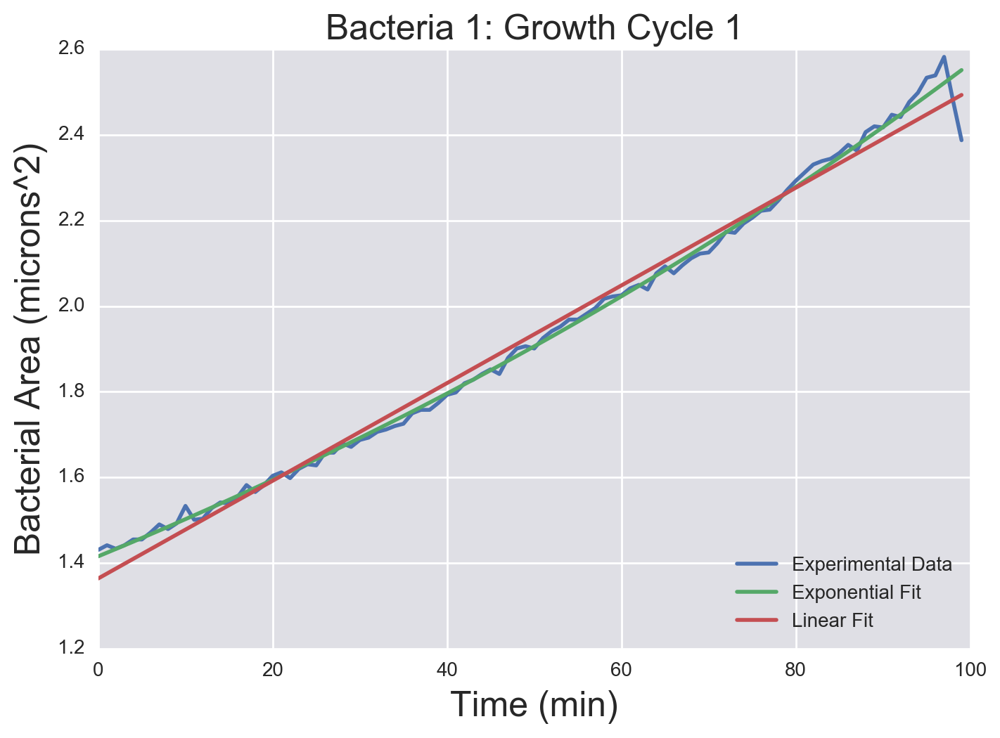

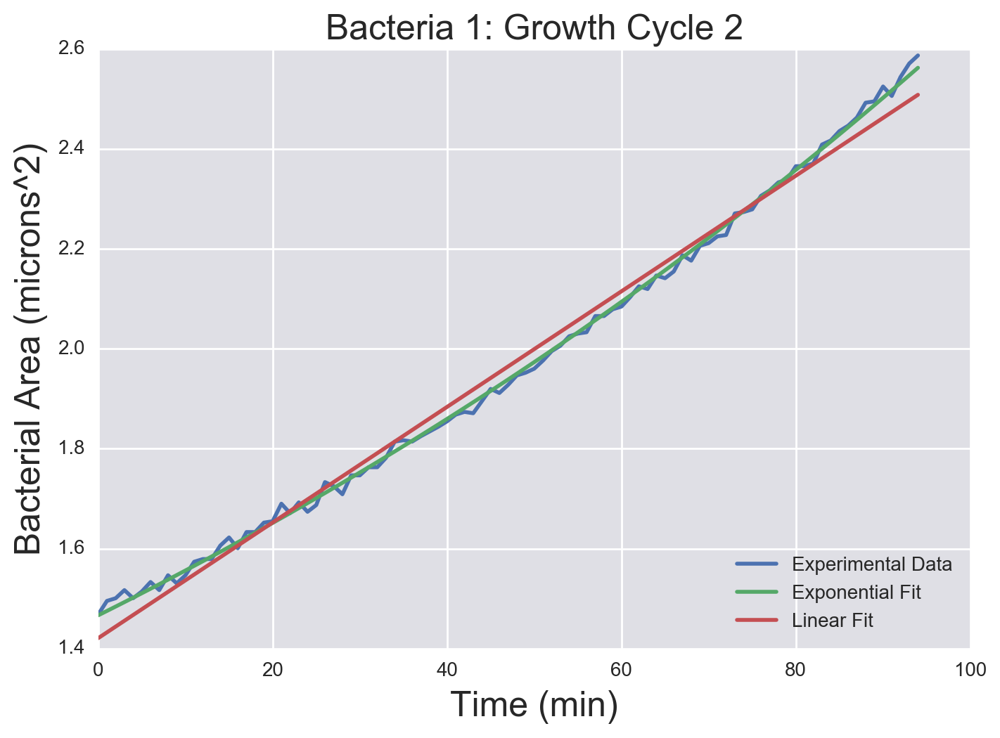

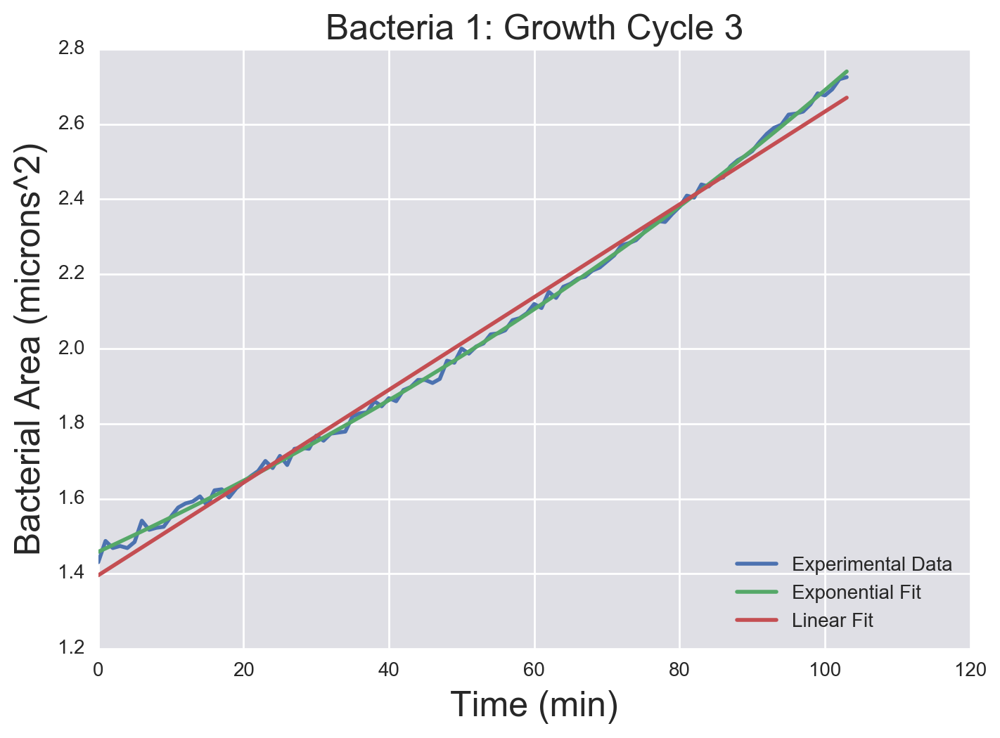

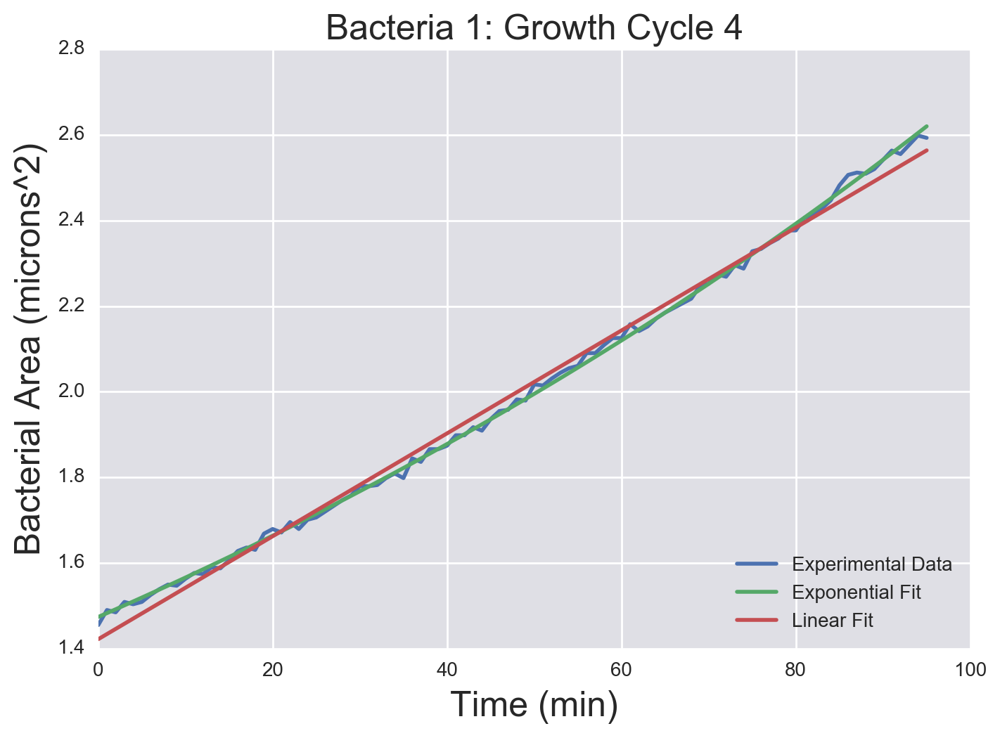

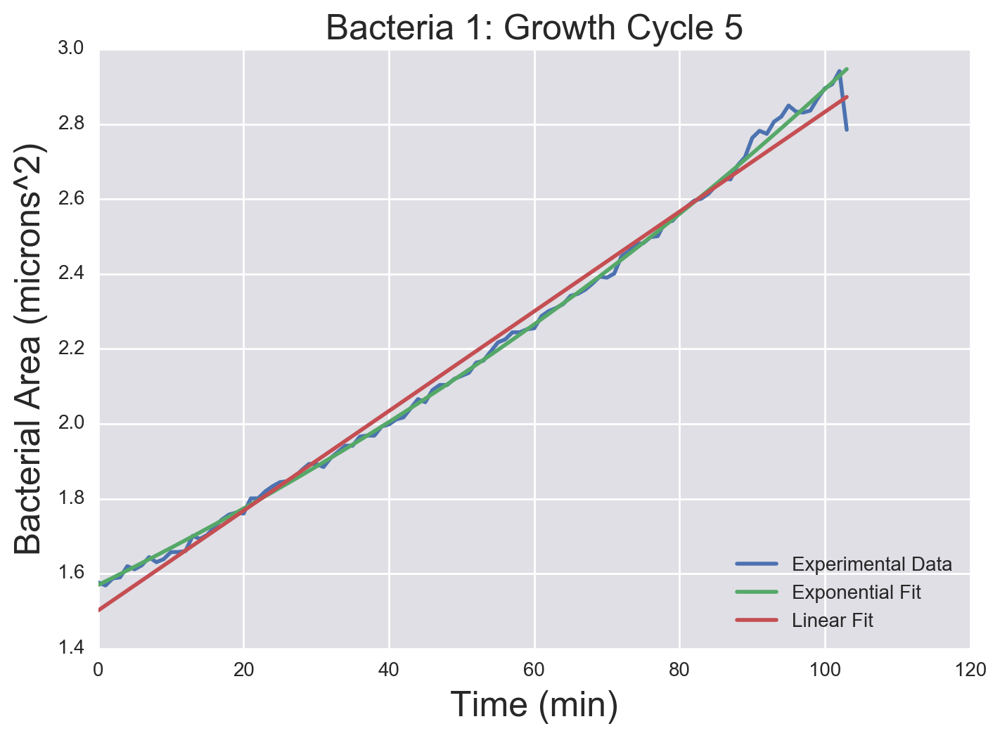

...

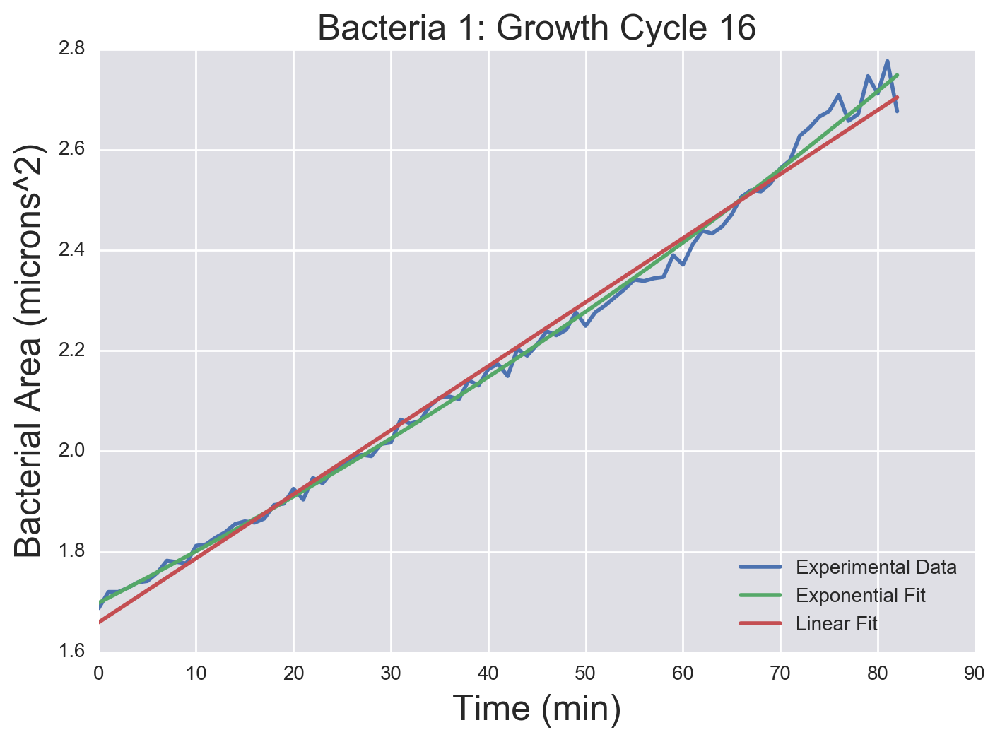

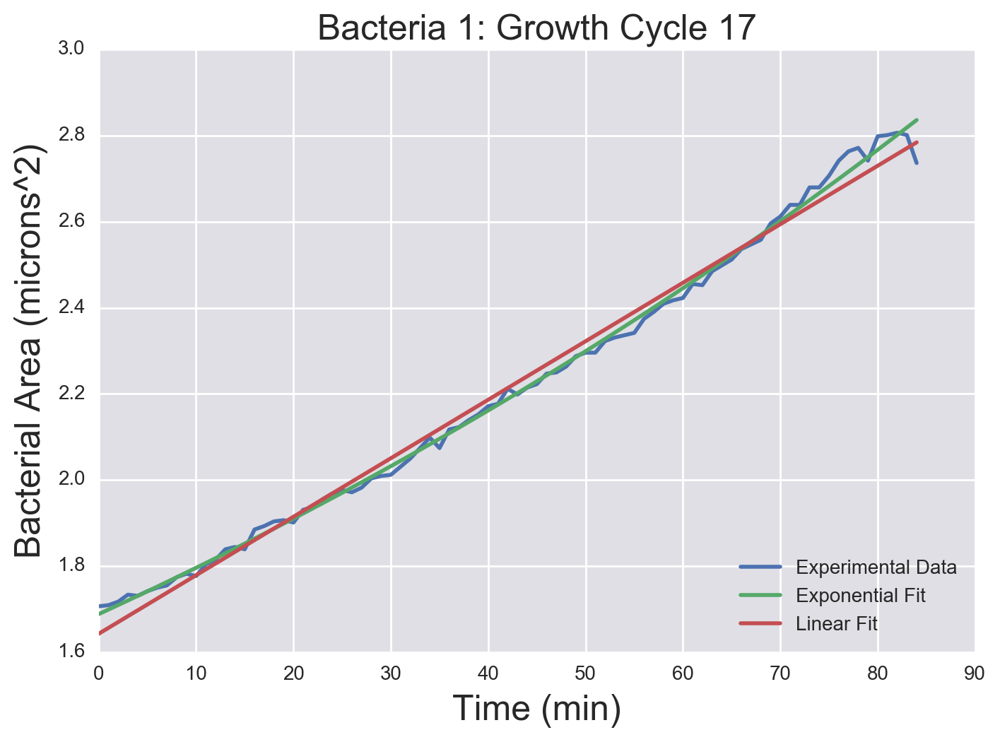

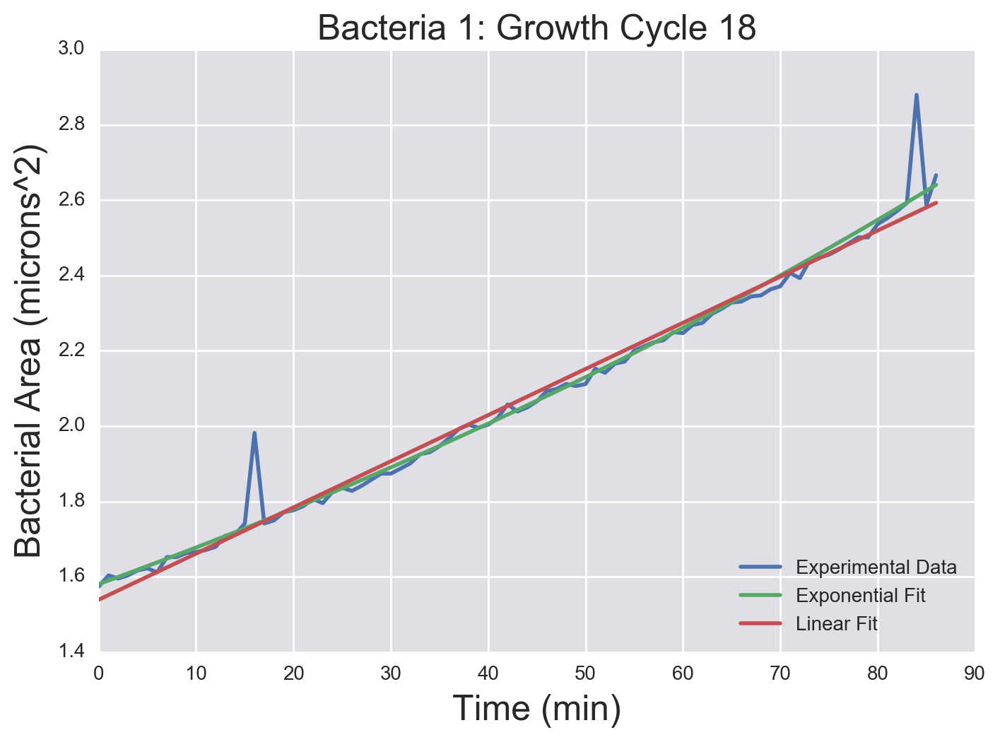

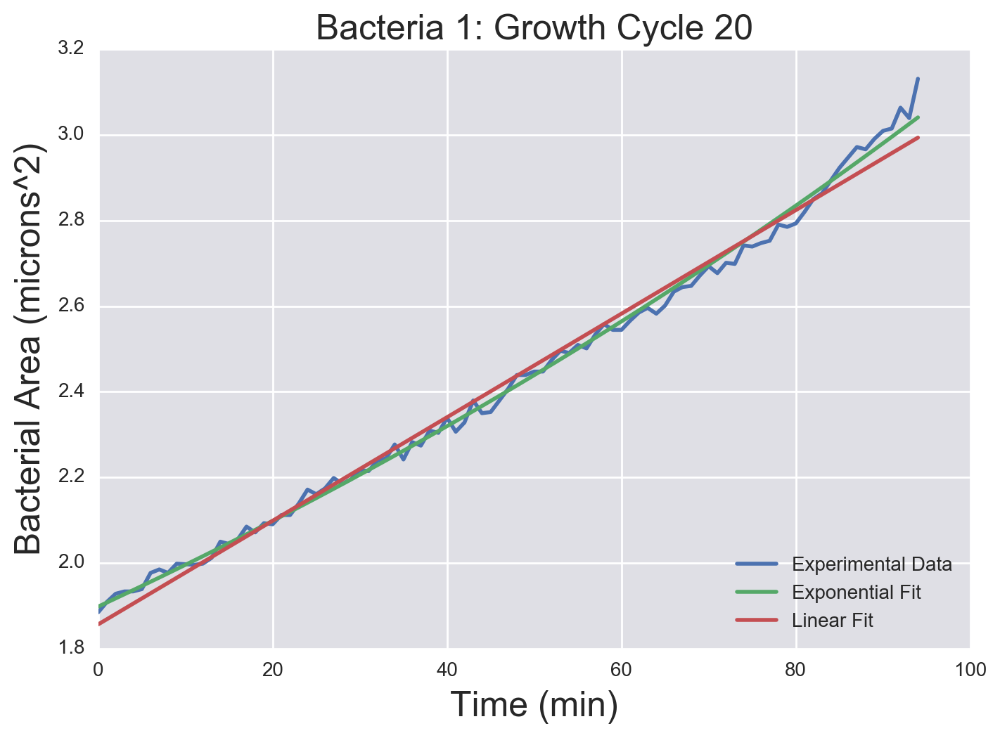

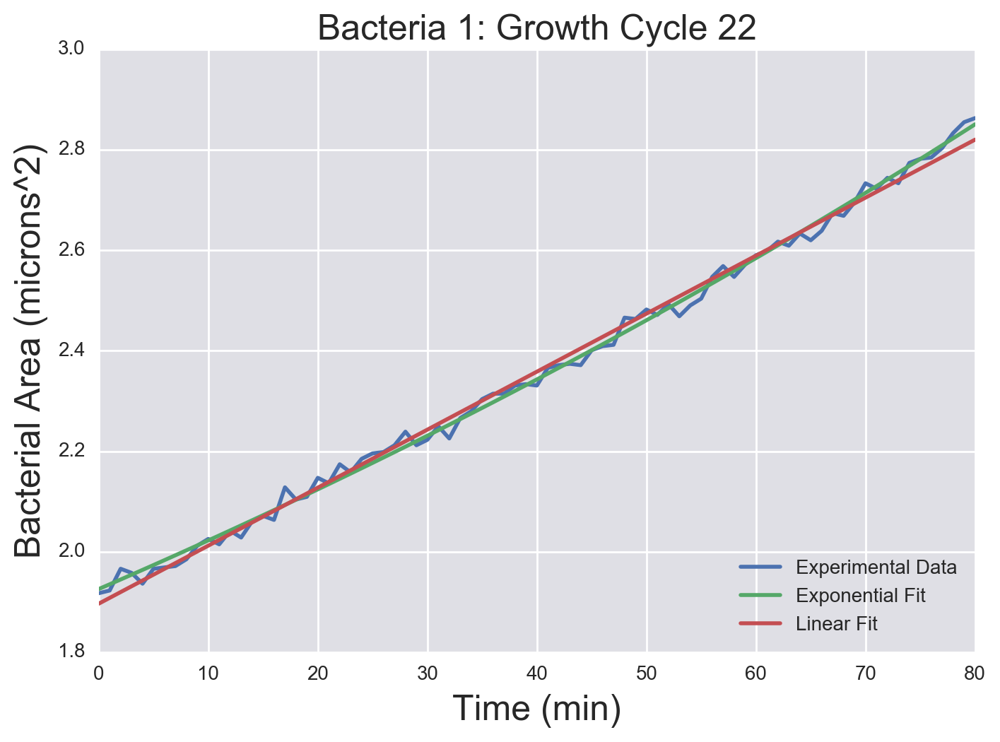

In [521]:
for growth_cycle in fit_results_model_1.keys():
    inds_to_extract = df_bac_1_final_less_noisy['growth_cycle_number'] == growth_cycle
    t = df_bac_1_final_less_noisy.loc[inds_to_extract, 'Time'].values 
    t_adjusted = t - t[0]
    a = df_bac_1_final_less_noisy.loc[inds_to_extract, 'Bac_area'].values
    popt_growth_cycle_exp = fit_results_model_1[growth_cycle]['popt']
    popt_growth_cycle_linear = fit_results_model_2[growth_cycle]['popt']
    plt.plot(t_adjusted, a, label='Experimental Data')
    plt.plot(t_adjusted, exponential_growth_model(t_adjusted, popt_growth_cycle_exp[0],popt_growth_cycle_exp[1] ), label='Exponential Fit' )
    plt.plot(t_adjusted, linear_growth_model(t_adjusted, popt_growth_cycle_linear[0],popt_growth_cycle_linear[1] ), label='Linear Fit' )
    plt.legend(loc='lower right')
    plt.xlabel('Time (min)')
    plt.ylabel('Bacterial Area (microns^2)')
    plt.title('Bacteria 1: Growth Cycle {}'.format(growth_cycle))
    plt.figure()



<div class="alert alert-info">Nice! Glad you got this working. Good to plot these together to see how they fit. My only queestion - would you say that the exopnential curve fits **much** better?</div>

By eye, it looks like the exponential curve fits the data much better than the linear fit. However, we can computationally find the odds ratio to actually compare the two models. 

Until, then we repeat the optimization process to find MAPs for bacteria 2. 

In [533]:
p_range_bac_2_model_1 = np.array([[1e-4, 2.5],
                    [1e-4, 5],
                    [1e-4, 5]])

sigma_init_bac_2_model_1 = 0.01
print('Bacteria 2: Exponential Fit Results')
fit_results_model_1_b2 = fit_all_growth_cycles(df_bac_2_less_noisy, p_range_bac_2_model_1,sigma_init_bac_2_model_1, exponential=True, print_results=True)


Bacteria 2: Exponential Fit Results


Most probable parameter values for growth cycle 1 using Model 1:
            a =     1.616 +- 0.00423
            k =     0.006 +- 0.00004
            sigma = 0.024 +- 0.00174
            


Most probable parameter values for growth cycle 2 using Model 1:
            a =     1.618 +- 0.03932
            k =     0.009 +- 0.00126
            sigma = 0.121 +- 0.01484
            


Most probable parameter values for growth cycle 3 using Model 1:
            a =     2.021 +- 0.00360
            k =     0.006 +- 0.00005
            sigma = 0.016 +- 0.00140
            


Most probable parameter values for growth cycle 4 using Model 1:
            a =     1.760 +- 0.00672
            k =     0.006 +- 0.00005
            sigma = 0.042 +- 0.00284
            


Most probable parameter values for growth cycle 5 using Model 1:
            a =     1.922 +- 0.00997
            k =     0.006 +- 0.00009
            sigma = 0.055 +- 0.00408
            


Most pr

In [534]:
p_range_bac_2_model_2 = np.array([[1e-4, 2.5],
                    [1e-4, 5],
                    [1e-4, 5]])

sigma_init_bac_2_model_2 = 0.01
print('Bacteria 2: Exponential Fit Results')
fit_results_model_2_b2 = fit_all_growth_cycles(df_bac_2_less_noisy, p_range_bac_2_model_1,sigma_init_bac_2_model_1, exponential=False, print_results=True)


Bacteria 2: Exponential Fit Results


Most probable parameter values for growth cycle 1 using Model 2:
            a =     1.562 += 0.006
            b =     0.013 += 0.000
            sigma = 0.030 += 0.002
            


Most probable parameter values for growth cycle 2 using Model 2:
            a =     1.613 += 0.042
            b =     0.016 += 0.002
            sigma = 0.123 += 0.015
            


Most probable parameter values for growth cycle 3 using Model 2:
            a =     1.994 += 0.004
            b =     0.015 += 0.000
            sigma = 0.018 += 0.002
            


Most probable parameter values for growth cycle 4 using Model 2:
            a =     1.675 += 0.008
            b =     0.015 += 0.000
            sigma = 0.042 += 0.003
            


Most probable parameter values for growth cycle 5 using Model 2:
            a =     1.860 += 0.010
            b =     0.015 += 0.000
            sigma = 0.048 += 0.004
            


Most probable parameter values for gr

C:\Users\Anvita Mishra\Anaconda3\lib\site-packages\matplotlib\pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


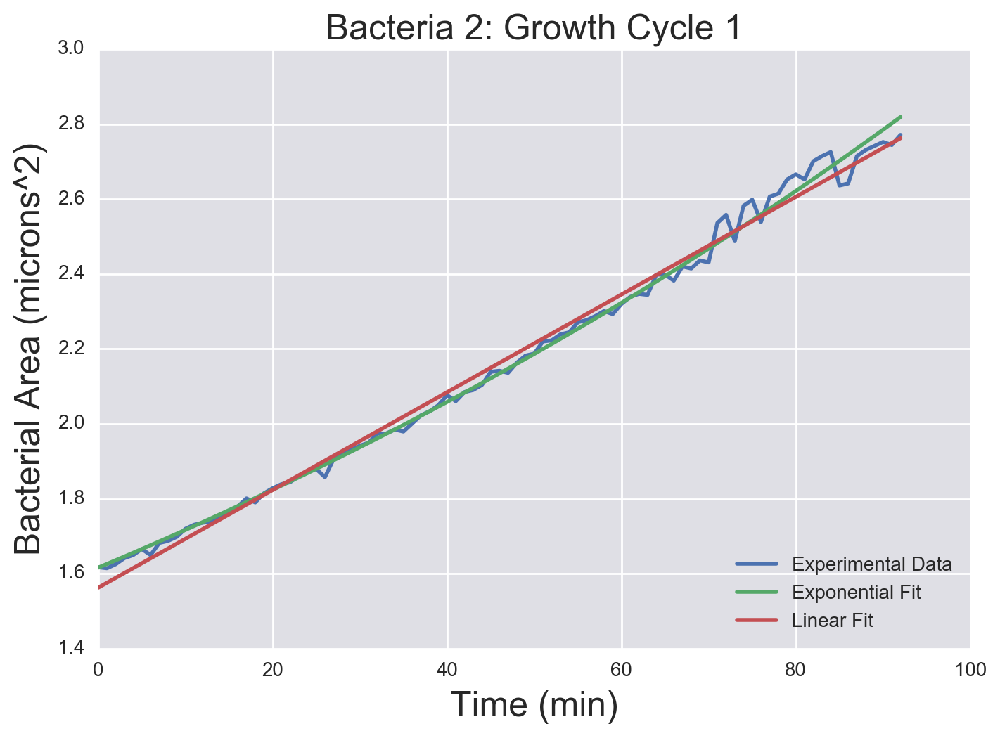

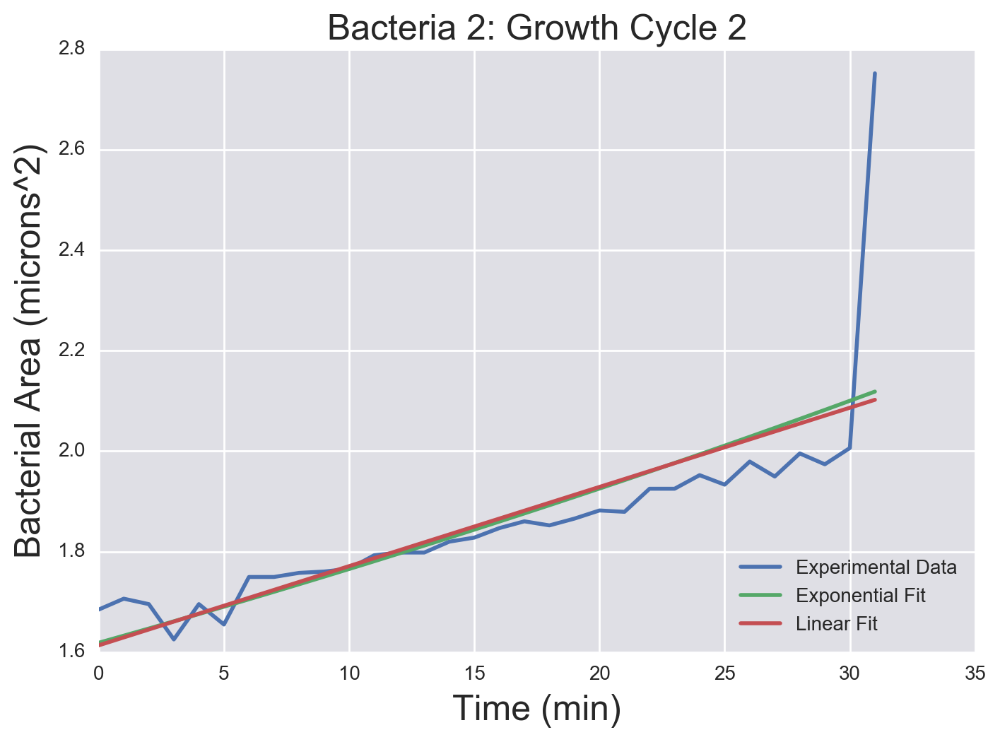

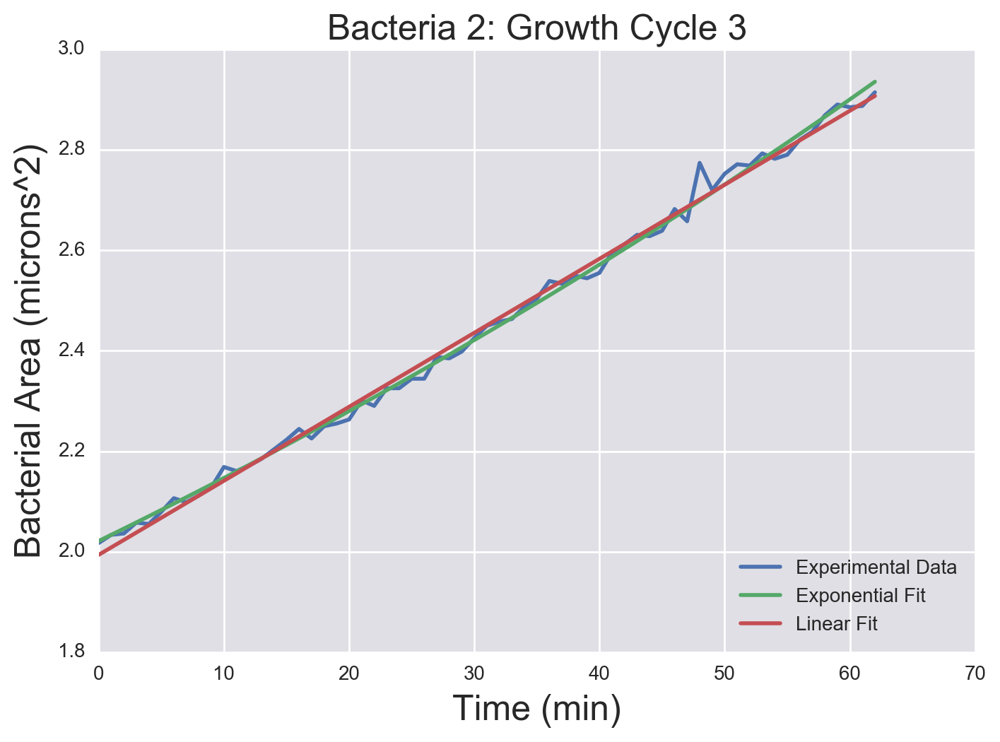

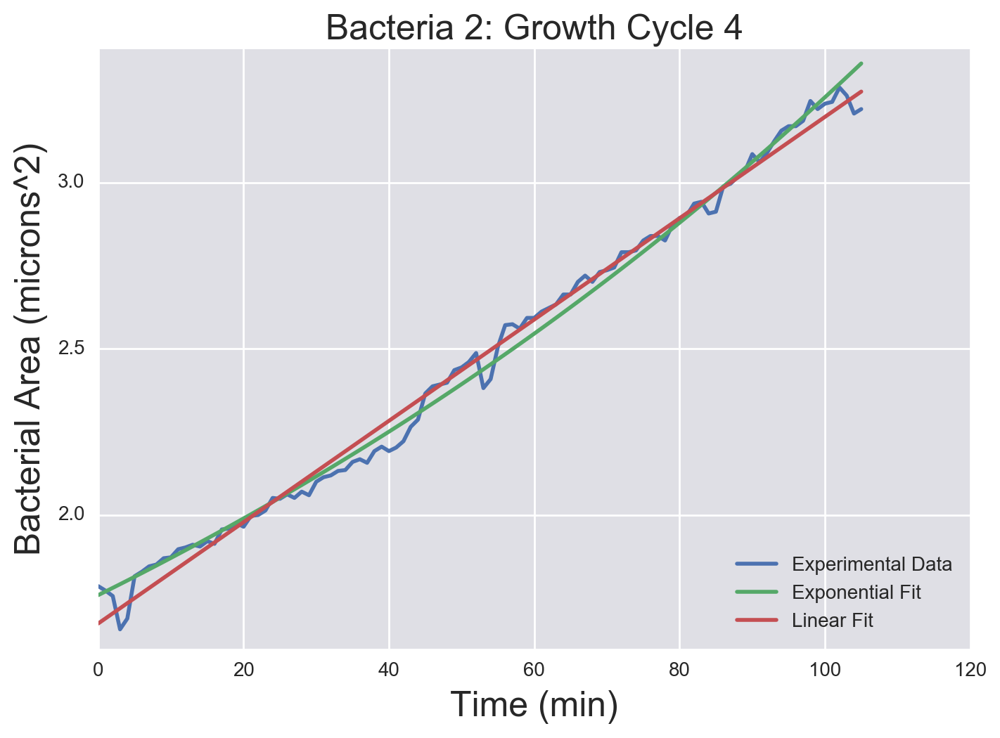

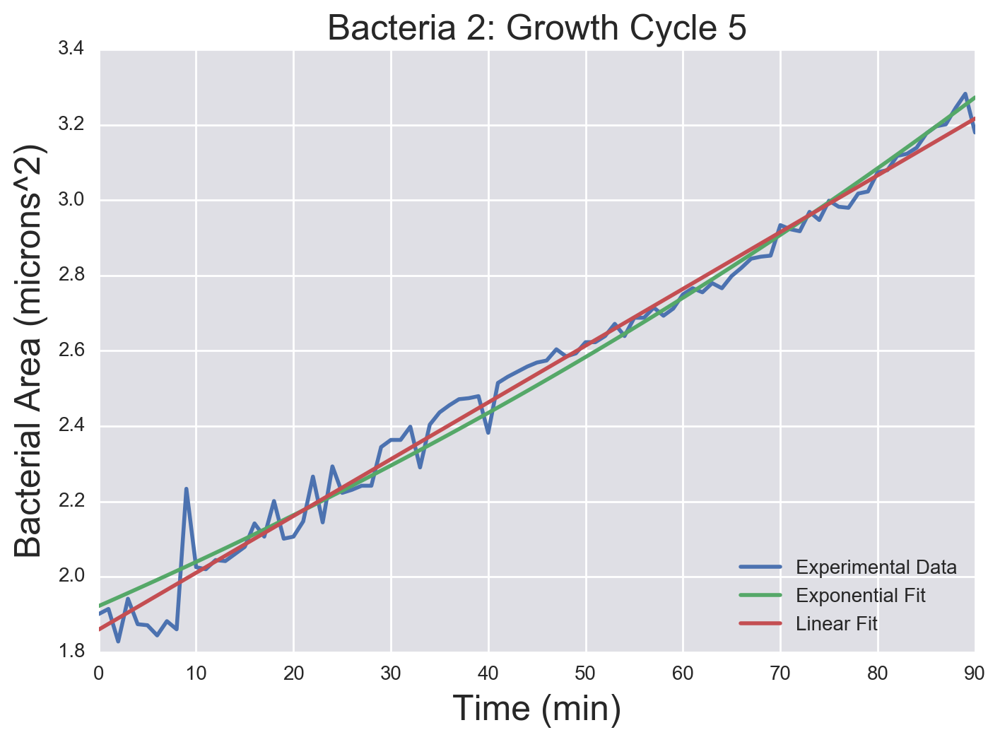

...

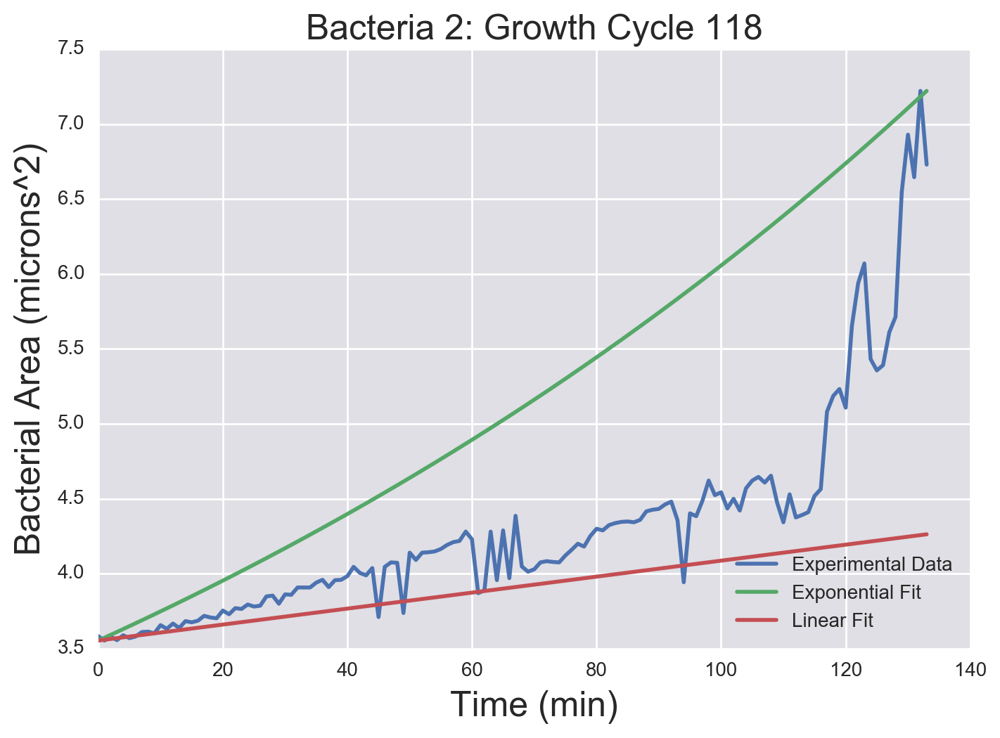

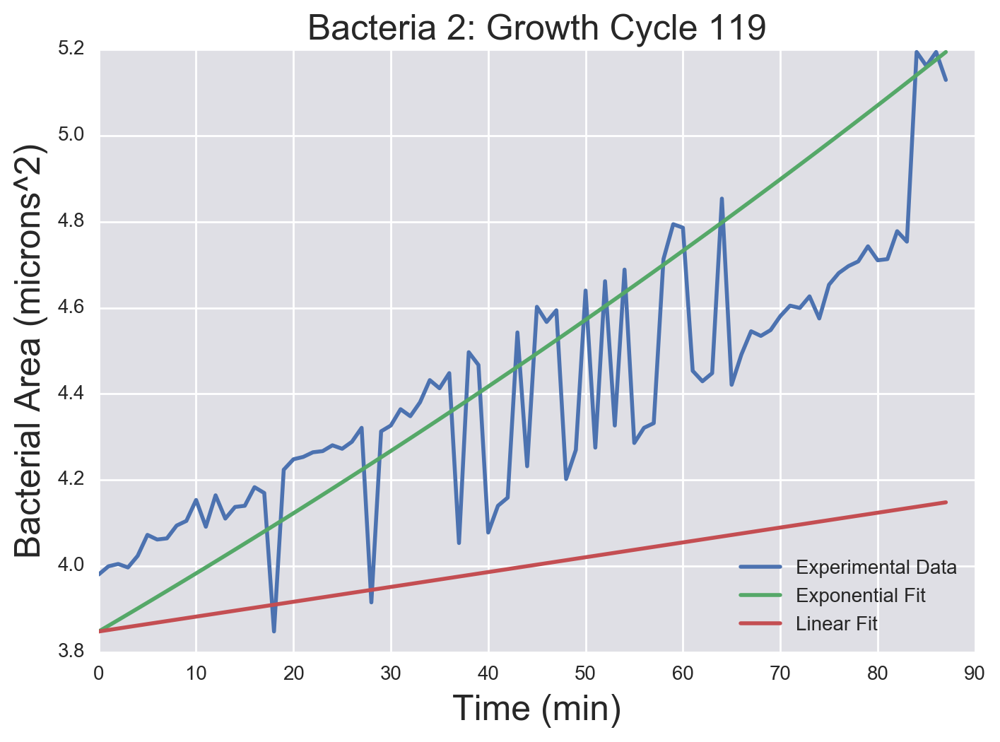

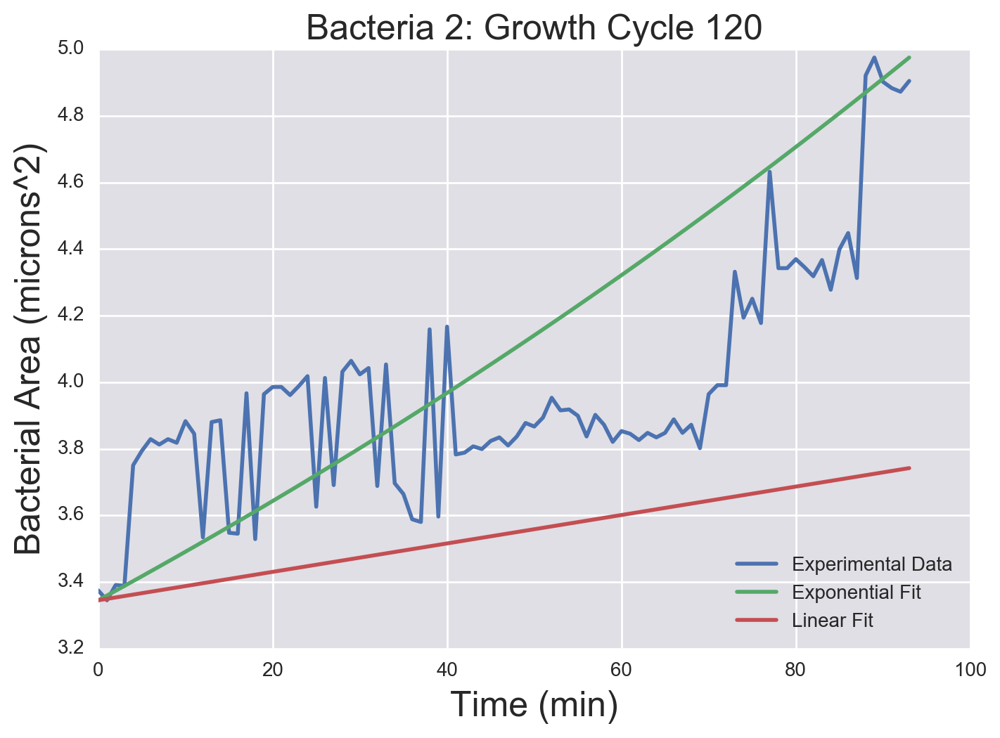

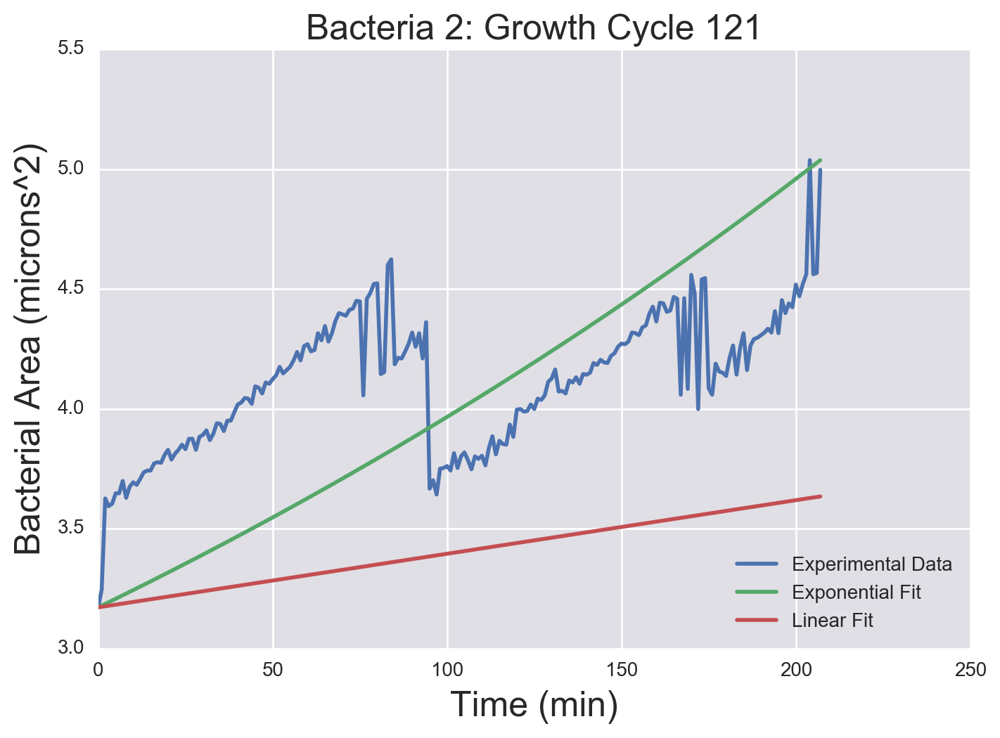

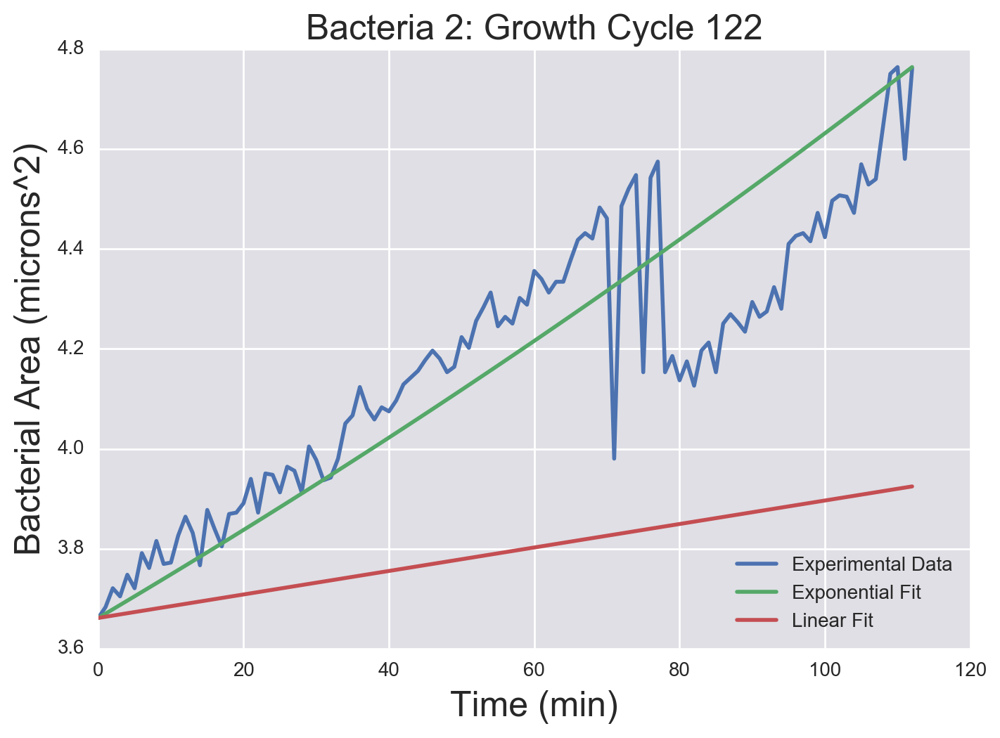

In [535]:
for growth_cycle in fit_results_model_1_b2.keys():
    inds_to_extract = df_bac_2_less_noisy['growth_cycle_number'] == growth_cycle
    t = df_bac_2_less_noisy.loc[inds_to_extract, 'Time'].values 
    t_adjusted = t - t[0]
    a = df_bac_2_less_noisy.loc[inds_to_extract, 'Bac_area'].values
    popt_growth_cycle_exp = fit_results_model_1_b2[growth_cycle]['popt']
    popt_growth_cycle_linear = fit_results_model_2_b2[growth_cycle]['popt']
    plt.plot(t_adjusted, a, label='Experimental Data')
    plt.plot(t_adjusted, exponential_growth_model(t_adjusted, popt_growth_cycle_exp[0],popt_growth_cycle_exp[1] ), label='Exponential Fit' )
    plt.plot(t_adjusted, linear_growth_model(t_adjusted, popt_growth_cycle_linear[0],popt_growth_cycle_linear[1] ), label='Linear Fit' )
    plt.legend(loc='lower right')
    plt.xlabel('Time (min)')
    plt.ylabel('Bacterial Area (microns^2)')
    plt.title('Bacteria 2: Growth Cycle {}'.format(growth_cycle))
    plt.figure()

We don't have very good fits at all. Optimization did not work for our data sets. However, if we compare this to Bacterium 1 where our data was fairly clean and homogenous, we see that our data is very noisy, so it makes sense that we're not getting any results. We need to clean up our data, and we probably need to guess initial positions for each data set. 

However, for the sake of time, we're going to keep this data and find the odds ratio to figure out which model is better.

<div class="alert alert-info">Yes, agreed.</div>

### Finding the Odds Ratio

To figure out which model is better, we will compare the odds ratio of the two models, which can be defined as the following. Since we assumed that each division was an independent dataset, we can write the "likelihood" as the joint probability of $D_1, D_2, ..., D_k$ as follows. 
\begin{align}
O_{ij} &= \frac{P(M_i \mid D_1, D_2, ..., D_k, I)}{P(M_j \mid D_1, D_2, ..., D_k, I)}\\
&= \frac{P(D_1, D_2, ..., D_k \mid M_i, I) P(M_i\mid I)}{P(D_1, D_2, ..., D_k \mid M_j, I)P(M_j\mid I)}\\
\end{align}

We know nothing about the models beforehand, so we will assume:
\begin{align}
\frac{P(M_i\mid I)}{P(M_j\mid I)} \approx 1,
\end{align}

Moreover, we will simplify this by using probability rules 
$$O_{ij} = \frac{P(D_1, D_2, ..., D_k \mid M_i, I)}{P(D_1, D_2, ..., D_k \mid M_j, I)} = \prod_{k} \frac{P(D_k \mid M_i, I)}{P(D_k \mid M_j, I)}$$

We can use the Laplace-Gaussian approximation to also write out the following pproximate odds ratio:

\begin{align}
O_{ij} \approx \prod_{k} \left(\frac{P(M_i\mid I)}{P(M_j\mid I)}\right)
\left(\frac{P(D_k\mid \theta^*, \sigma^*, M_i, I)}{P(D_k\mid \theta^*, \gamma^*, \sigma^*, M_j, I)}\right)
\left(\frac{P(\theta^*, \sigma^* \mid M_i, I) \,(2\pi)^{3/2}\,\sqrt{\det\boldsymbol{\sigma_{M_i}^2}}}
{P(\theta^*, \gamma^*, \sigma^*\mid M_j, I)\,(2\pi)^{3/2} \sqrt{\det\boldsymbol{\sigma}_{M_j}^2}}\right),
\end{align}

where the asterisks denote the most probable parameter values (the MAP), and $\boldsymbol{\sigma}_i$ is the covariance matrix computed for Model $i$. 

We can code all of this as follows

##### Bacterium 1


<div class="alert alert-info">Good explanation. You can be slightly more specific. When you "simplify with probability rules," you're saying that the joint probability of independent events (i.e. the probability that two unrelated things both happen) is the product of the probability of each event. You should also point out that $\frac{P(D_k \mid M_i, I)}{P(D_k \mid M_j, I)}$ is the odds ratio for a given dataset, $D_k$, which is why you substitute in the Laplace approximation. Also, don't forget to point out that the Laplace approximation works best / only if the function is sharply peaked (i.e. Gaussian). So using this assumes that the product of likelihood and prior is sharply peaked (which is true for this problem!).</div>

In [537]:
# Exp / Linear
def log_occam(log_prior_1, popt_1, prior_args_1, cov_1,
              log_prior_2, popt_2, prior_args_2, cov_2):
    """
    Compute approximate log Occam factor.
    """    
    log_prior_ratio = log_prior_1(popt_1, *prior_args_1) \
                                - log_prior_2(popt_2, *prior_args_2)
    log_dets = (np.log(np.linalg.det(cov_1)) - np.log(np.linalg.det(cov_2))) / 2
    log_2pi_ratio = (len(popt_1) - len(popt_2)) * np.log(2 * np.pi)
    return log_prior_ratio + log_dets + log_2pi_ratio

total_odds_ratio = 0

for growth_cycle in fit_results_model_2.keys():
    inds_to_extract = df_bac_1_final_less_noisy['growth_cycle_number'] == growth_cycle
    t = df_bac_1_final_less_noisy.loc[inds_to_extract, 'Time'].values 
    t_adjusted = t - t[0]
    a = df_bac_1_final_less_noisy.loc[inds_to_extract, 'Bac_area'].values
    
    popt_exp = fit_results_model_1[growth_cycle]['popt']
    popt_linear = fit_results_model_2[growth_cycle]['popt']
    cov_exp = fit_results_model_1[growth_cycle]['cov']
    cov_linear = fit_results_model_2[growth_cycle]['cov']
    
    like_args_exp = ((t_adjusted, a), True)
    like_args_linear = ((t_adjusted, a), False)
    
    log_goodfit_exp_linear = log_likelihood_gaussian(popt_exp, *like_args_exp) \
                    - log_likelihood_gaussian(popt_linear, *like_args_linear)
        
    
    
    p_range = np.array([[1e-4, 2.5],
                        [1e-4, 1],
                        [1e-4, 5]])
    prior_args_1 = (p_range, True)
    prior_args_2 = (p_range, False)
    
    # Occam factor for exp/gamma
    log_occam_exp_linear = log_occam(log_prior, popt_exp, prior_args_1, cov_exp,
                log_prior, popt_linear, prior_args_2, cov_linear)
    
    total_odds_ratio = total_odds_ratio + log_goodfit_exp_linear + log_occam_exp_linear 
    
    print('\nGrowth cycle {}:'.format(growth_cycle))
    print('log10 goodness of fit exp/linear: ', log_goodfit_exp_linear/np.log(10))
    print('log10 Occam factor exp/linear: ', log_occam_exp_linear/np.log(10))
    print('log10 Odds ratio exp/linear: ',log_goodfit_exp_linear/np.log(10) + log_occam_exp_linear/np.log(10) )

print('\nlog final Odds ratio: {}'.format(total_odds_ratio))


Growth cycle 1:
log10 goodness of fit exp/linear:  18.2118217484
log10 Occam factor exp/linear:  0.463485492871
log10 Odds ratio exp/linear:  18.6753072412

Growth cycle 2:
log10 goodness of fit exp/linear:  38.93599536
log10 Occam factor exp/linear:  0.00263507139467
log10 Odds ratio exp/linear:  38.9386304314

Growth cycle 3:
log10 goodness of fit exp/linear:  44.0421726894
log10 Occam factor exp/linear:  -0.0674122097275
log10 Odds ratio exp/linear:  43.9747604797

Growth cycle 4:
log10 goodness of fit exp/linear:  34.0876031587
log10 Occam factor exp/linear:  0.0991814625272
log10 Odds ratio exp/linear:  34.1867846213

Growth cycle 5:
log10 goodness of fit exp/linear:  23.8354198369
log10 Occam factor exp/linear:  0.290022262938
log10 Odds ratio exp/linear:  24.1254420998

Growth cycle 6:
log10 goodness of fit exp/linear:  14.6618180416
log10 Occam factor exp/linear:  0.427074760971
log10 Odds ratio exp/linear:  15.0888928026

Growth cycle 7:
log10 goodness of fit exp/linear:  24.

<div class="alert alert-info">Nice thoughtful explanation below. Just be careful about saying that a convincing result must be an accurate result. It's possible that if we included a hierarchical model, we'd actually get a smaller odds ratio. (In fact, I believe this is the case - when you are no longer fitting each dataset with entirely independent data sets, the fit parameters are constrained, so the goodness of fit is longer quite so large).</div>

Looking at the overall trends, it seems like goodness of fit ratio for all of the growth cycles favors the expoential model over the linear model. These goodness of fit ratios are pretty large. Looking over all of the Occam factors, it seems like linear model is slightly favored over exponential model. However, since the goodness of fit ratios are so much largery, these occam factors barely make a dent. The odds ratio is pretty large. A large odds ratio is good. It's sufficiently extreme that it seems like the exponential model is a much better fit. It also means that neglecting some of the aspects of the hierarchical model wasn't the worse thing in the world. 

Rinse and repeat for Bacteria 2. 

#### Bacteria 2

Since optimization didn't really work for bacteria 2, it doesn't really make sense to finds all of the odds ratios. We should only find it for when it did work (no nans), but I spent a while experimenting with isnan() to figure out how to do that but I couldn't figure it out. :(

In [552]:

total_odds_ratio_b2 = 0
list_popt = [] 
for growth_cycle in fit_results_model_2_b2.keys():
    popt_exp = fit_results_model_1_b2[growth_cycle]['popt']
    popt_linear = fit_results_model_2_b2[growth_cycle]['popt']
    cov_exp = fit_results_model_1_b2[growth_cycle]['cov']
    cov_linear =fit_results_model_2_b2[growth_cycle]['cov']
    

    inds_to_extract = df_bac_2_less_noisy['growth_cycle_number'] == growth_cycle
    
        
    t = df_bac_2_less_noisy.loc[inds_to_extract, 'Time'].values 
    t_adjusted = t - t[0]
    a = df_bac_2_less_noisy.loc[inds_to_extract, 'Bac_area'].values



    like_args_exp = ((t_adjusted, a), True)
    like_args_linear = ((t_adjusted, a), False)

    log_goodfit_exp_linear = log_likelihood_gaussian(popt_exp, *like_args_exp) \
                    - log_likelihood_gaussian(popt_linear, *like_args_linear)



    p_range = np.array([[1e-4, 2.5],
                        [1e-4, 1],
                        [1e-4, 5]])
    prior_args_1 = (p_range, True)
    prior_args_2 = (p_range, False)

    # Occam factor for exp/gamma
    log_occam_exp_linear = log_occam(log_prior, popt_exp, prior_args_1, cov_exp,
                log_prior, popt_linear, prior_args_2, cov_linear)

    total_odds_ratio = total_odds_ratio + log_goodfit_exp_linear + log_occam_exp_linear 

    print('\nGrowth cycle {}:'.format(growth_cycle))
    print('log10 goodness of fit exp/linear: ', log_goodfit_exp_linear/np.log(10))
    print('log10 Occam factor exp/linear: ', log_occam_exp_linear/np.log(10))
    print('log10 Odds ratio exp/linear: ',log_goodfit_exp_linear/np.log(10) + log_occam_exp_linear/np.log(10) )

print('\n log Final Odds ratio: {}'.format(total_odds_ratio))


Growth cycle 1:
log10 goodness of fit exp/linear:  9.34032340665
log10 Occam factor exp/linear:  0.578614796054
log10 Odds ratio exp/linear:  9.91893820271

Growth cycle 2:
log10 goodness of fit exp/linear:  0.224012409629
log10 Occam factor exp/linear:  0.757902115893
log10 Odds ratio exp/linear:  0.981914525522

Growth cycle 3:
log10 goodness of fit exp/linear:  3.41005347547
log10 Occam factor exp/linear:  0.669533138663
log10 Odds ratio exp/linear:  4.07958661413

Growth cycle 4:
log10 goodness of fit exp/linear:  0.112431768164
log10 Occam factor exp/linear:  0.683149406979
log10 Odds ratio exp/linear:  0.795581175144

Growth cycle 5:
log10 goodness of fit exp/linear:  -5.43982907112
log10 Occam factor exp/linear:  0.843735343672
log10 Odds ratio exp/linear:  -4.59609372745

Growth cycle 6:
log10 goodness of fit exp/linear:  -0.206162374188
log10 Occam factor exp/linear:  0.781202406225
log10 Odds ratio exp/linear:  0.575040032037

Growth cycle 7:
log10 goodness of fit exp/linear

I guess it wasn't completely necessary to figure out when optimization didn't work. It's pretty obvious from the odds ratio results. But even when optimization did work, our results aren't consistent. Sometimes the goodness of fit is less than 1 where it favors the linear model, or sometimes it is much greater than 1. However, if we think back to all of the noise in our data, these results make sense. We need to clean up our data before we can make any other conclusions. This might mean resorting to more advanced segmentation techniques, or heaven forbid, as we learned in part (b), we could pick a different bacteria that is more isolated where we don't run into these segmentation problems. 

<div class="alert alert-info">Based on the fits you plotted, I think it makes sense that you would get results going both ways - some of the fits looked quite poor.</div>

<div class="alert alert-info">Final for Part C: 50.5/55</div>